<a href="https://colab.research.google.com/github/shahshawaiz/artwork-style-prediction/blob/master/Copy_of_artwork_style.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
# # activate kaggle, mount grdive, download/unzip dataset
# import os
# os.environ['KAGGLE_USERNAME'] = "shahshawaiz" # username from the json file
# os.environ['KAGGLE_KEY'] = "476e4fb10eef6d9da79358d4df0db985" # key from the json file

from google.colab import drive
drive.mount('/content/drive')

# files = ['train_1.zip', 'train_2.zip', 'train_3.zip', 'train_4.zip', 'train_5.zip', 'train_6.zip', 'train_7.zip', 'train_8.zip', 'train_9.zip']
# for path in files:
#   path_dir = path.strip('.zip')
#   path_gdrive = '/content/drive/My Drive/Colab Notebooks/dataset/wikiart/train'

#   !kaggle competitions download -c painter-by-numbers -f "$path"
#   !unzip -qq "$path"
#   !mv -n "$path_dir"/ "$path_gdrive"/
#   !rm -rf "$path" "$path_dir"

# # drive.flush_and_unmount()   

# # # # extract zip
# # # # !unzip '/content/drive/My Drive/university/s3/lfi/project/data/train_1.zip'

# # from tensorflow.python.client import device_lib
# # print(device_lib.list_local_devices())

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
# pkgs installation
# !pip install tensorflow h5py pyyaml

In [0]:
# imports
import numpy as np
import pandas as pd
import os
import time
from keras.applications.resnet50 import ResNet50
from keras.preprocessing import image
from keras.layers import GlobalAveragePooling2D, Dense, Dropout,Activation,Flatten
from keras.callbacks import ModelCheckpoint

from keras.applications.vgg16 import preprocess_input
from keras.layers import Input
from keras.models import Model, load_model
from keras.utils import np_utils
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split

from typing import Any, Dict, List, Optional, Pattern, Set, Tuple

Using TensorFlow backend.


In [0]:
# set env
MODEL_VERSION = 'd'
PATH = '/content/drive/My Drive/Colab Notebooks/dataset/wikiart'
PATH_IMAGES = PATH + '/train'
PATH_VISUALIZE = PATH + '/visualize'
PATH_METADATA = PATH + '/all_data_info.csv'
PATH_MODEL = PATH + '/models/m-' + MODEL_VERSION + '.h5'
PATH_CHECKPOINT = PATH + '/checkpoints/cp-' + MODEL_VERSION + '.ckpt'
PATH_MISSING_LOG = PATH + '/missing/ms-' + MODEL_VERSION + '.txt'
CHECKPOINT_PERIOD = 3
SLICE_SIZE = 2500
NUM_CLASSES = 10

In [0]:
# read dataset
def read_data():
  img_list = []
  img_missing_list = []

  # metadata
  metadata = pd.read_csv(PATH_METADATA)
  print("top n: ", metadata.groupby(['style']).style.value_counts().nlargest(NUM_CLASSES))

  top_n_classes = metadata.groupby(['style']).style.value_counts().nlargest(NUM_CLASSES).index.get_level_values(0).values.tolist() # get first n classes
  metadata = metadata[metadata['style'].isin(top_n_classes)] # filter metadata w.r.t classes  
  images_path = metadata['new_filename'].sample(n=SLICE_SIZE, random_state=1).values.tolist()
  metadata = metadata[metadata['new_filename'].isin(images_path)] # filter metadata w.r.t slice size

  train_dirs = os.listdir(PATH_IMAGES)
  # train_dirs = ['train_1', 'train_2']

  # read images
  for filename in images_path:
    image_missing = True

    for train_dir in train_dirs:
        img_path = PATH_IMAGES + '/'+ train_dir + '/' + filename	
        try:
          img = image.load_img(img_path, target_size=(224, 224))
          x = image.img_to_array(img)
          x = np.expand_dims(x, axis=0)
          x = preprocess_input(x)
          img_list.append(x)

          image_missing = False
        except OSError as e:
          pass
      
    if image_missing:
      img_missing_list.append(filename)

  # convert to float32, fix shape
  images = np.array(img_list)
  images = images.astype('float32')
  images = np.rollaxis(images,1,0)
  
  # remove missing files from metadata
  metadata = metadata[~metadata['new_filename'].isin(img_missing_list)] 
  
  # log missing
  np.savetxt(PATH_MISSING_LOG, np.array(img_missing_list), fmt="%s")
  
  return images[0], metadata

def factorize(metadata):
	metadata['style_code'] = metadata['style'].astype('category')
	metadata['style_code'] = pd.factorize(metadata.style_code)[0]
	
	return metadata

def get_categories(labels):
	return np_utils.to_categorical(labels, NUM_CLASSES)
	
def shuffle_data(images, Y):
  x, y = shuffle(images, Y, random_state=2)
  return train_test_split(x, y, test_size=0.2, random_state=2)

In [0]:
def resnet_init():
  #image_input = Input(shape=(224, 224, 3))
  model = ResNet50(weights='imagenet', include_top=False)
  print(model.summary()  )

  return model

In [0]:
def resnet_retrain_classifier(model):
  last_layer = model.output
  # add a global spatial average pooling layer
  x = GlobalAveragePooling2D()(last_layer)
  # add fully-connected & dropout layers
  x = Dense(512, activation='relu',name='fc-1')(x)
  x = Dropout(0.5)(x)
  x = Dense(256, activation='relu',name='fc-2')(x)
  x = Dropout(0.5)(x)
  # a softmax layer for n classes
  out = Dense(NUM_CLASSES, activation='softmax',name='output_layer')(x)  

  return out

In [0]:
def get_retrained_resnet(model, out):
  # # this is the model we will train
  model = Model(inputs=model.input, outputs=out)
  
  for layer in model.layers[:-6]:
    layer.trainable = False

  model.layers[-1].trainable
  model.compile(loss='categorical_crossentropy',optimizer='adam',metrics=['accuracy'])  
  
  model.summary()

  return model

In [0]:
def set_checkpoints():
  checkpoint_dir = os.path.dirname(PATH_CHECKPOINT)

  # create checkpount
  return ModelCheckpoint(filepath=PATH_CHECKPOINT, save_weights_only=True, verbose=1, period=CHECKPOINT_PERIOD)

In [0]:
def get_saved_model():
  model = None
  
  try:
    model = load_model(PATH_MODEL)
    print("Model found at: ", PATH_MODEL)
  except OSError as e:
    print("Model doesn't exist")
    
  return model

def set_weights(model): 
  try:
    model.load_weights(PATH_CHECKPOINT)
    print("Checkpoint found at: ", PATH_CHECKPOINT)
  except OSError as e:
    print("Checkpoint doesn't exist")

  return model

In [0]:
def model_create():

	model = get_saved_model()
	if model is None:
		model = resnet_init()
		out = resnet_retrain_classifier(model)
		model = get_retrained_resnet(model, out)
	
	model = set_weights(model)
 
	return model

In [0]:
def model_fit(
    model, X_train, y_train, X_test, y_test, cp_callback
):
  t=time.time()
  hist = model.fit(
      X_train, y_train, batch_size=32, epochs=12, verbose=1, validation_data=(X_test, y_test), callbacks=[cp_callback]
  )
  print('Training time: %s' % (t - time.time()))
  (loss, accuracy) = model.evaluate(X_test, y_test, batch_size=10, verbose=1)

  print("[INFO] loss={:.4f}, accuracy: {:.4f}%".format(loss,accuracy * 100))  

  return model, hist

In [0]:
def model_visiualize(hist):
  
  import matplotlib.pyplot as plt
  # visualizing losses and accuracy
  train_loss=hist.history['loss']
  val_loss=hist.history['val_loss']
  train_acc=hist.history['acc']
  val_acc=hist.history['val_acc']
  xc=range(12)

  plt.figure(1,figsize=(7,5))
  plt.plot(xc,train_loss)
  plt.plot(xc,val_loss)
  plt.xlabel('num of Epochs')
  plt.ylabel('loss')
  plt.title('train_loss vs val_loss')
  plt.grid(True)
  plt.legend(['train','val'])
  #print plt.style.available # use bmh, classic,ggplot for big pictures
  plt.style.use(['classic'])

  plt.figure(2,figsize=(7,5))
  plt.plot(xc,train_acc)
  plt.plot(xc,val_acc)
  plt.xlabel('num of Epochs')
  plt.ylabel('accuracy')
  plt.title('train_acc vs val_acc')
  plt.grid(True)
  plt.legend(['train','val'],loc=4)
  #print plt.style.available # use bmh, classic,ggplot for big pictures
  plt.style.use(['classic'])  

In [0]:
images, metadata = read_data()

top n:  style                 style               
Impressionism         Impressionism           10643
Realism               Realism                 10523
Romanticism           Romanticism              9285
Expressionism         Expressionism            7013
Post-Impressionism    Post-Impressionism       5778
Art Nouveau (Modern)  Art Nouveau (Modern)     4899
Baroque               Baroque                  4400
Surrealism            Surrealism               4167
Symbolism             Symbolism                3476
Rococo                Rococo                   2733
Name: style, dtype: int64















Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Model found at:  /content/drive/My Drive/Colab Notebooks/dataset/wikiart/models/m-d.h5
Checkpoint found at:  /content/drive/My Drive/Colab Notebooks/dataset/wikiart/checkpoints/cp-d.ckpt
Train on 4 samples, validate on 2 samples
Epoch 1/12
4/4 [==============================] - 8s 2s/step - loss: 3.7915 - acc: 0.7500 - val_loss: 10.0321 - val_acc: 0.0000e+00
Epoch 2/12
4/4 [==============================] - 0s 8ms/step - loss: 1.8529 - acc: 0.2500 - val_loss: 9.8663 - val_acc: 0.0000e+00
Epoch 3/12
4/4 [==============================] - 0s 8ms/step - loss: 1.7847 - acc: 0.7500 - val_loss: 9.6925 - val_acc: 0.0000e+00

Epoch 00003: saving model to /content/drive/My Drive/Colab Notebooks/dataset/wikiart/checkpoints/cp-d.ckpt
Epoch 4/12
4/4 [=========================

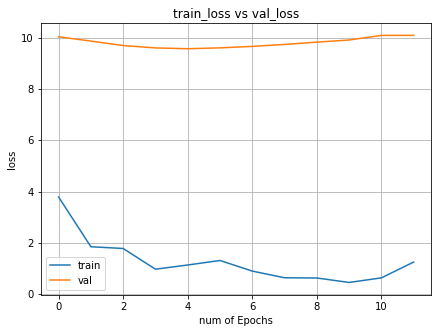

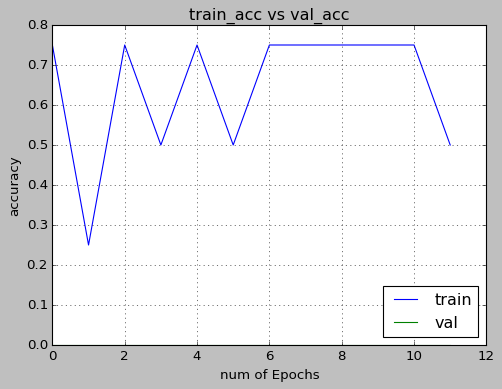

In [0]:
metadata = factorize(metadata)
Y = get_categories(metadata.style_code)
X_train, X_test, y_train, y_test = shuffle_data(images, Y)

cp_callback = set_checkpoints()

model = model_create()
model, hist = model_fit(
    model, X_train, y_train, X_test, y_test, cp_callback
)
model.save(PATH_MODEL)

model_visiualize(hist)

res2a_branch2a - (1, 1, 64, 64)


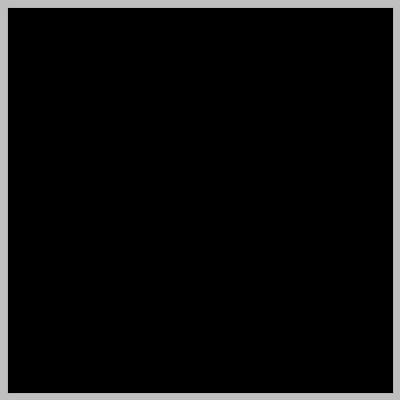

res2a_branch2b - (3, 3, 64, 64)


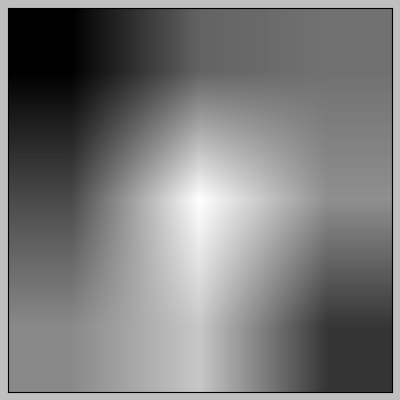

res2a_branch2c - (1, 1, 64, 256)


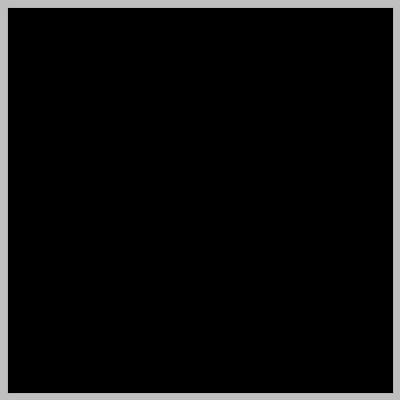

res2a_branch1 - (1, 1, 64, 256)


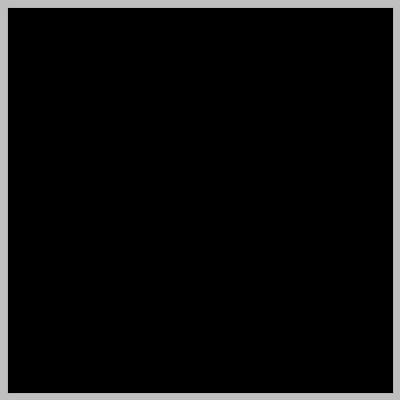

res2b_branch2a - (1, 1, 256, 64)


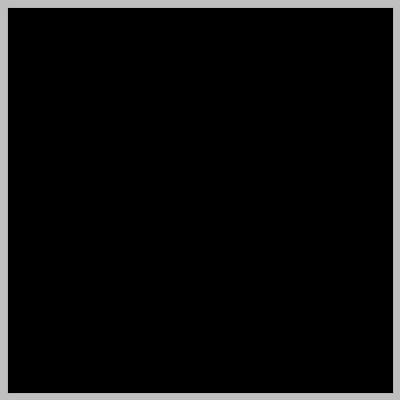

res2b_branch2b - (3, 3, 64, 64)


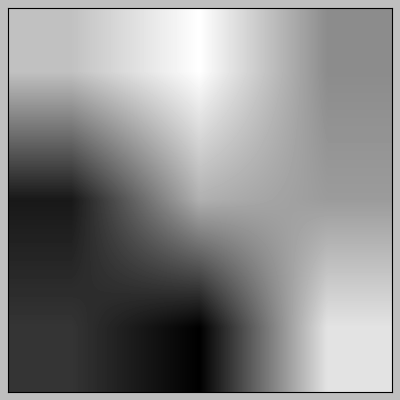

res2b_branch2c - (1, 1, 64, 256)


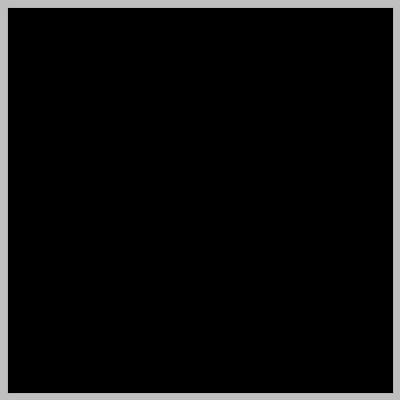

res2c_branch2a - (1, 1, 256, 64)


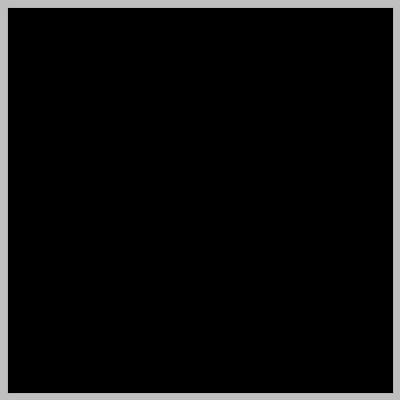

res2c_branch2b - (3, 3, 64, 64)


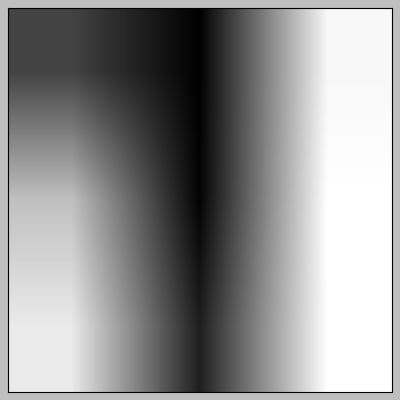

res2c_branch2c - (1, 1, 64, 256)


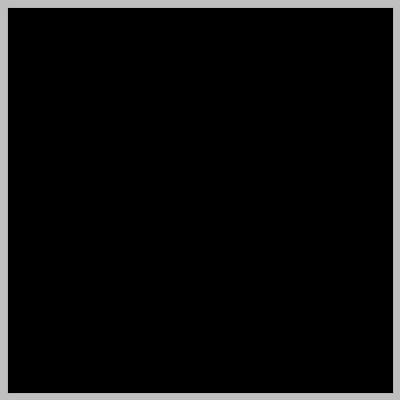

res3a_branch2a - (1, 1, 256, 128)


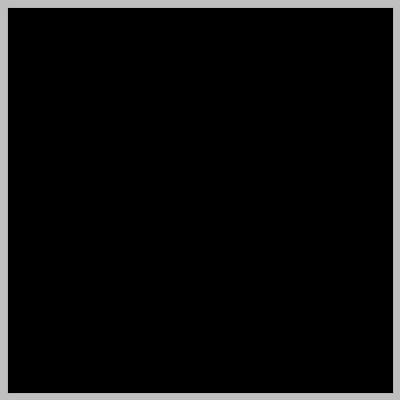

res3a_branch2b - (3, 3, 128, 128)


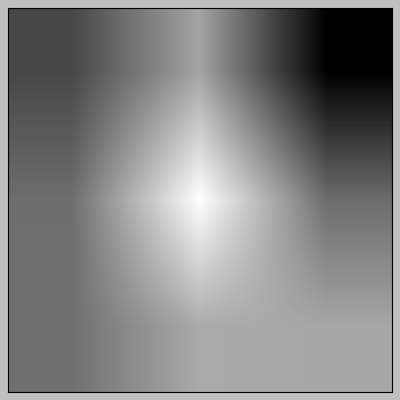

res3a_branch2c - (1, 1, 128, 512)


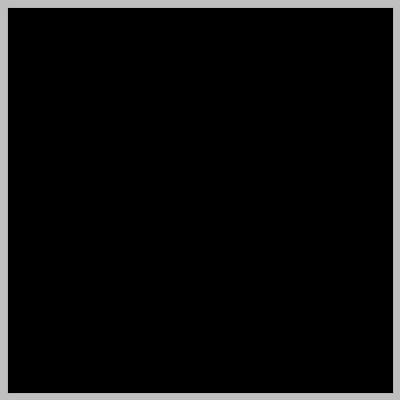

res3a_branch1 - (1, 1, 256, 512)


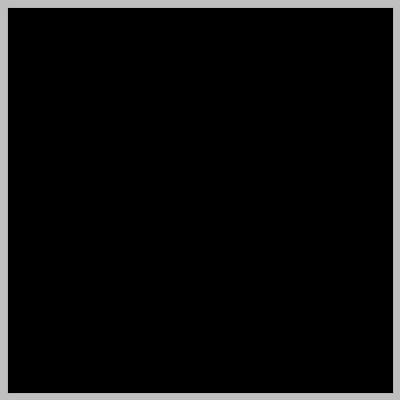

res3b_branch2a - (1, 1, 512, 128)


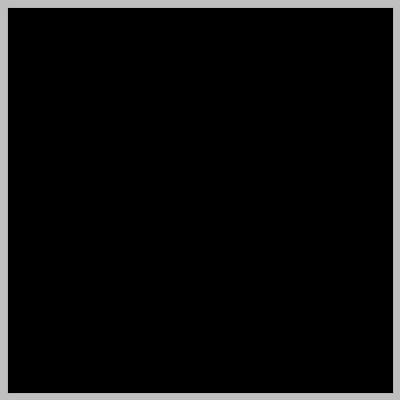

res3b_branch2b - (3, 3, 128, 128)


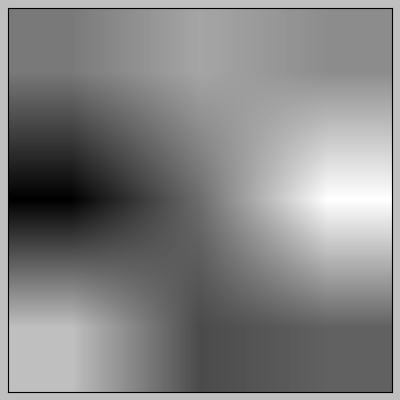

res3b_branch2c - (1, 1, 128, 512)


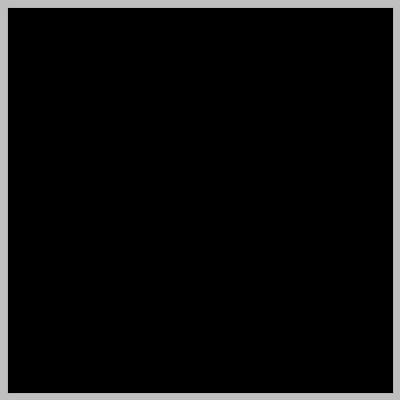

res3c_branch2a - (1, 1, 512, 128)


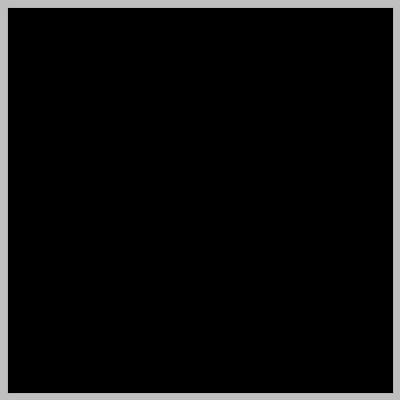

res3c_branch2b - (3, 3, 128, 128)


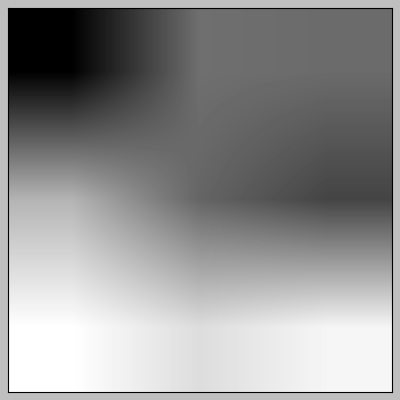

res3c_branch2c - (1, 1, 128, 512)


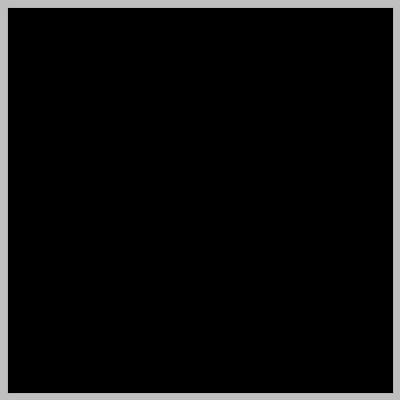

res3d_branch2a - (1, 1, 512, 128)


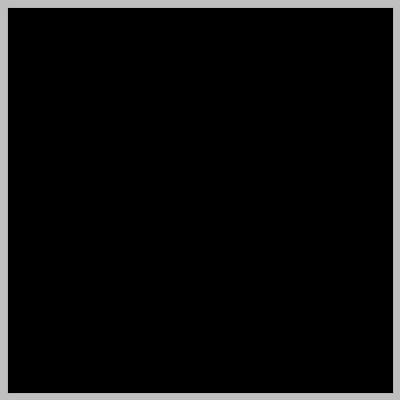

res3d_branch2b - (3, 3, 128, 128)


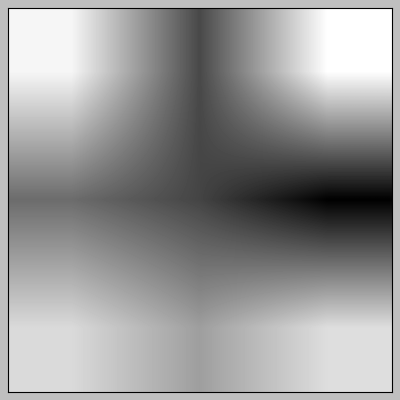

res3d_branch2c - (1, 1, 128, 512)


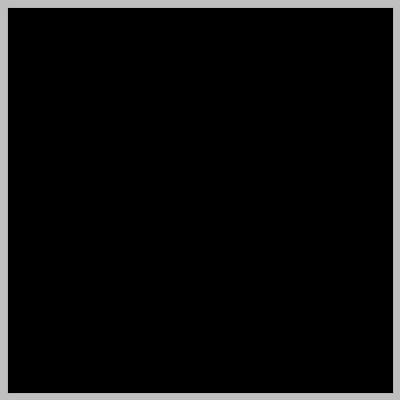

res4a_branch2a - (1, 1, 512, 256)


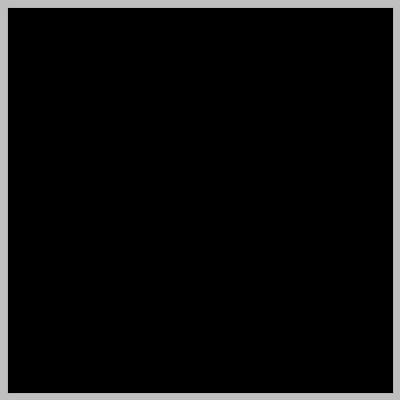

res4a_branch2b - (3, 3, 256, 256)


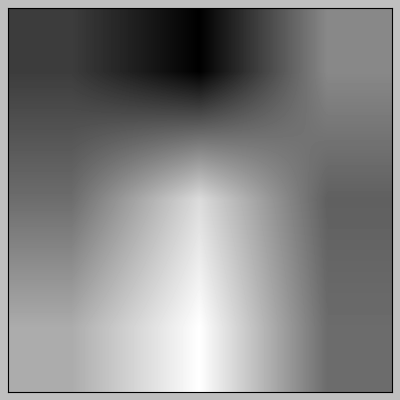

res4a_branch2c - (1, 1, 256, 1024)


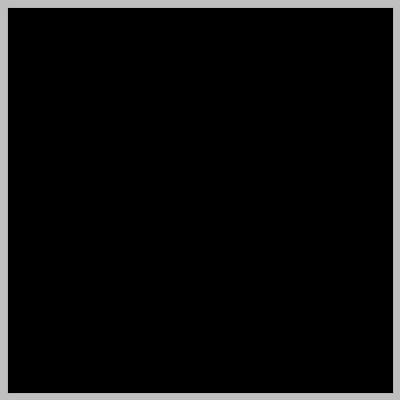

res4a_branch1 - (1, 1, 512, 1024)


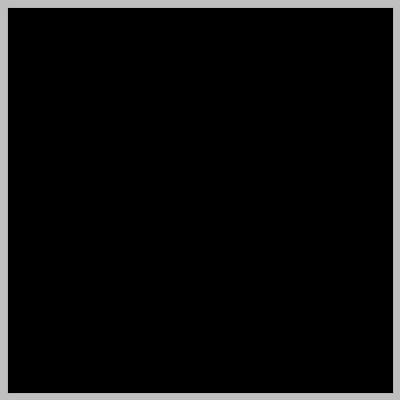

res4b_branch2a - (1, 1, 1024, 256)


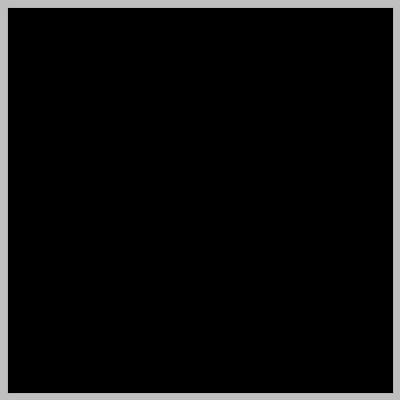

res4b_branch2b - (3, 3, 256, 256)


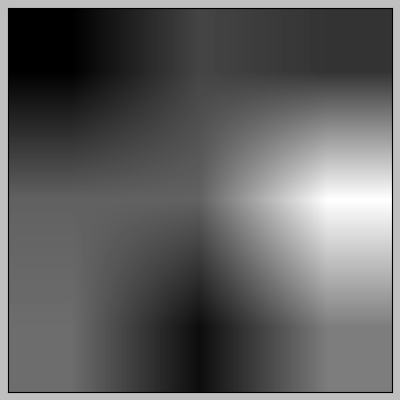

res4b_branch2c - (1, 1, 256, 1024)


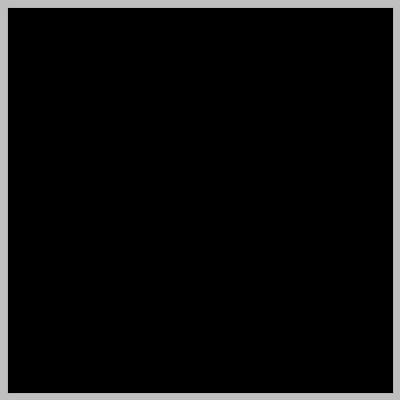

res4c_branch2a - (1, 1, 1024, 256)


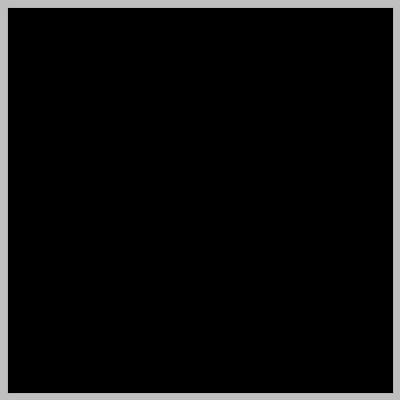

res4c_branch2b - (3, 3, 256, 256)


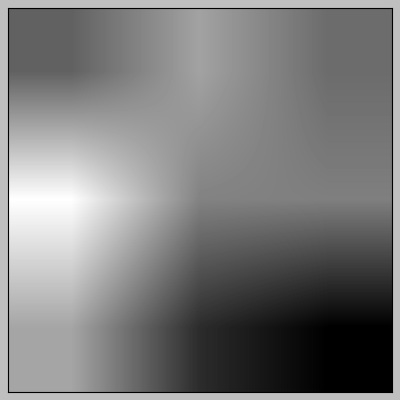

res4c_branch2c - (1, 1, 256, 1024)


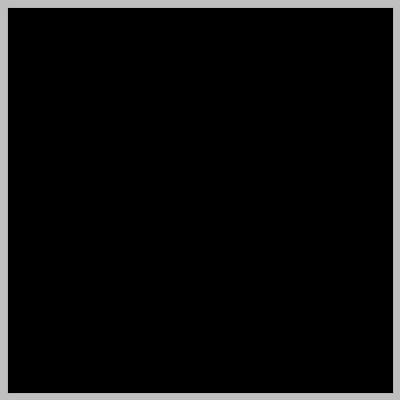

res4d_branch2a - (1, 1, 1024, 256)


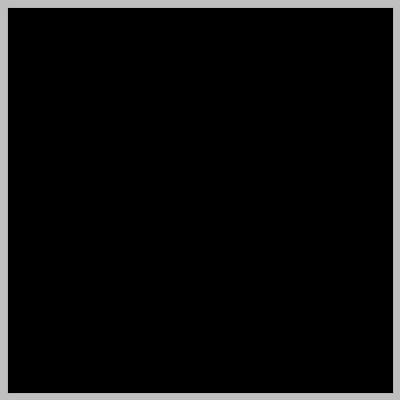

res4d_branch2b - (3, 3, 256, 256)


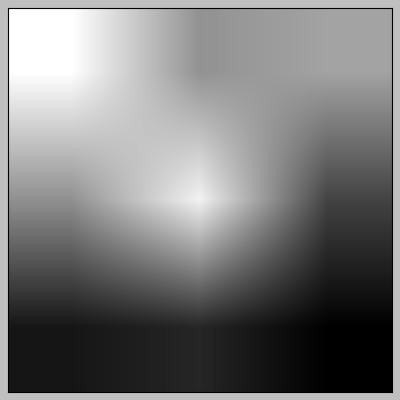

res4d_branch2c - (1, 1, 256, 1024)


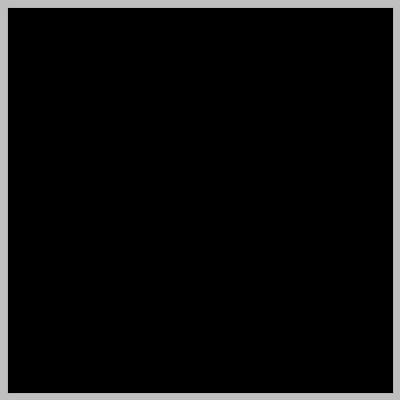

res4e_branch2a - (1, 1, 1024, 256)


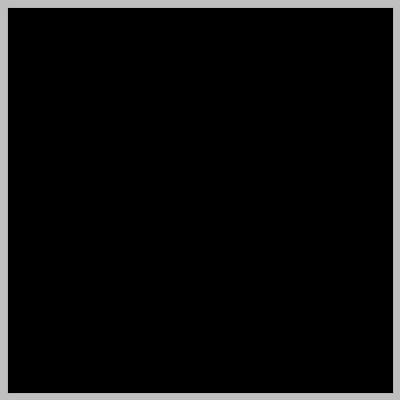

res4e_branch2b - (3, 3, 256, 256)


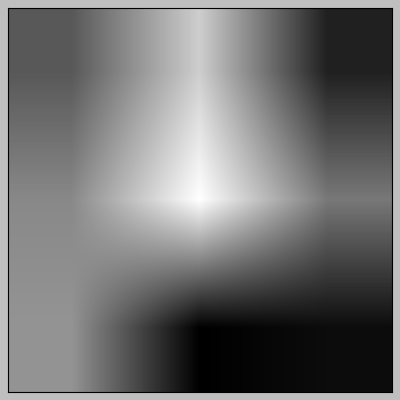

res4e_branch2c - (1, 1, 256, 1024)


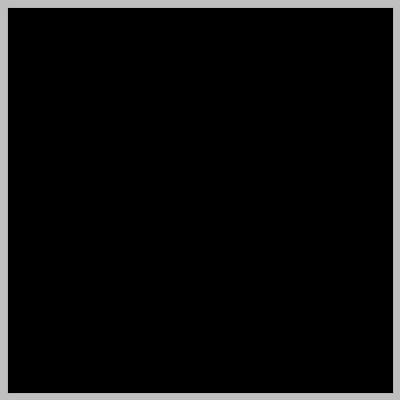

res4f_branch2a - (1, 1, 1024, 256)


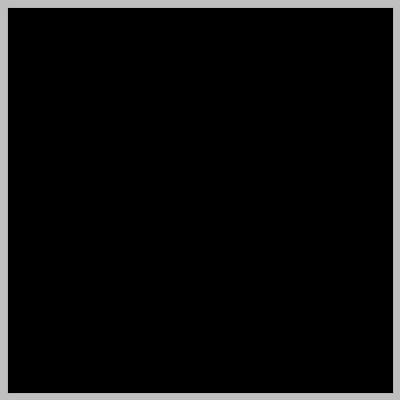

res4f_branch2b - (3, 3, 256, 256)


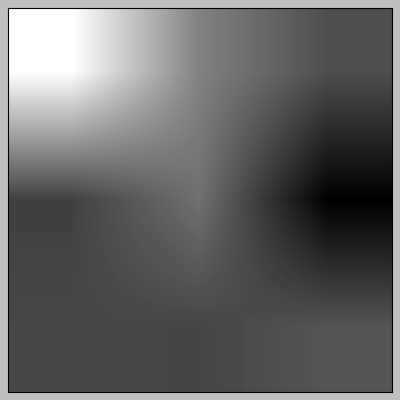

res4f_branch2c - (1, 1, 256, 1024)


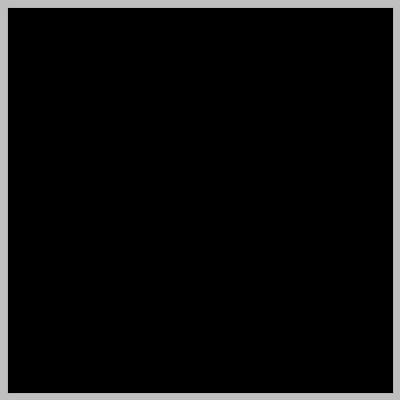

res5a_branch2a - (1, 1, 1024, 512)


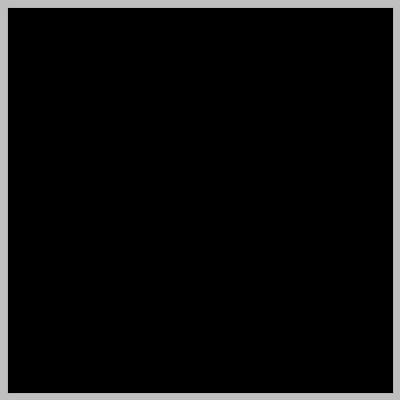

res5a_branch2b - (3, 3, 512, 512)


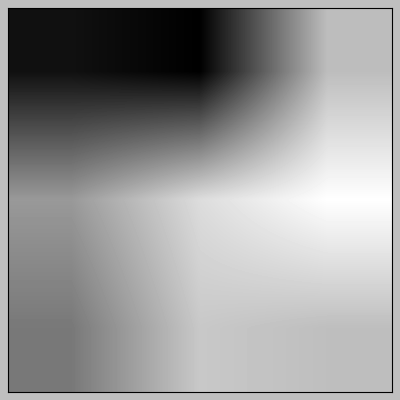

res5a_branch2c - (1, 1, 512, 2048)


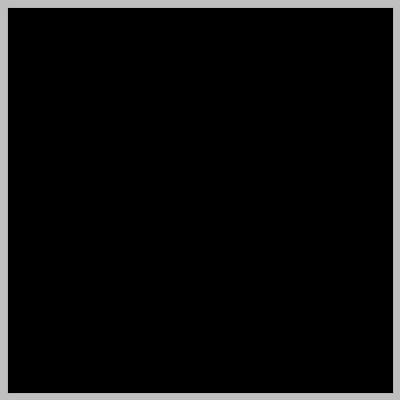

res5a_branch1 - (1, 1, 1024, 2048)


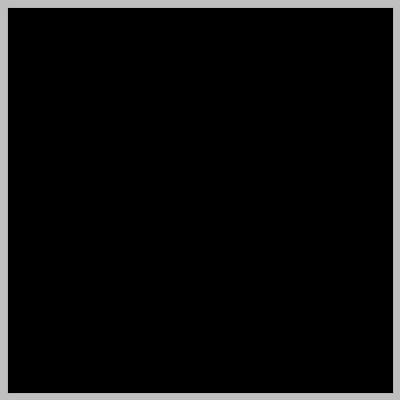

res5b_branch2a - (1, 1, 2048, 512)


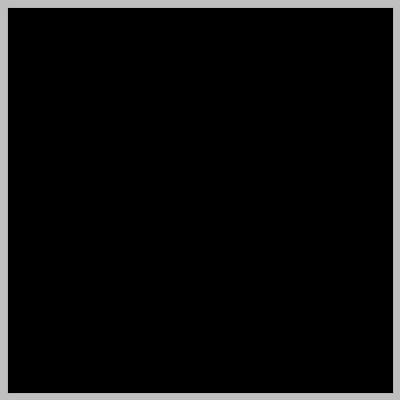

res5b_branch2b - (3, 3, 512, 512)


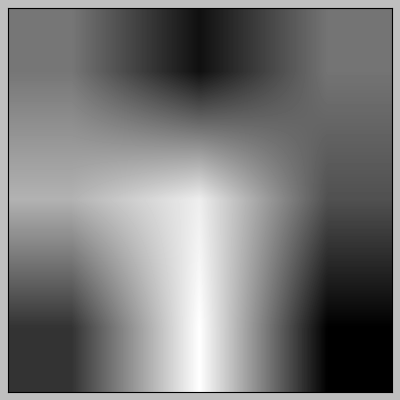

res5b_branch2c - (1, 1, 512, 2048)


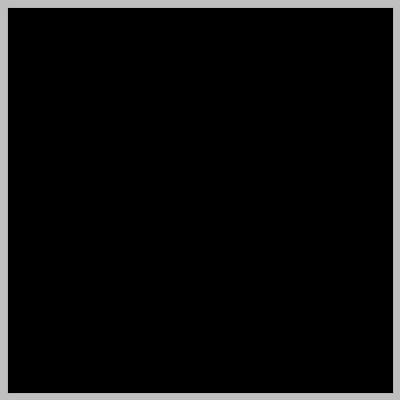

res5c_branch2a - (1, 1, 2048, 512)


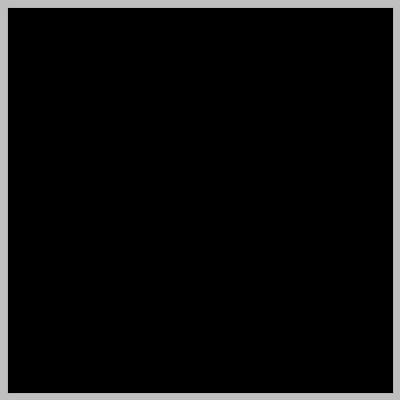

res5c_branch2b - (3, 3, 512, 512)


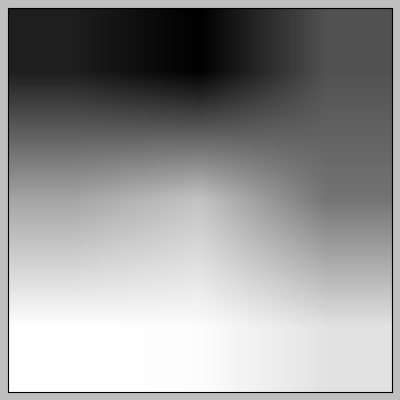

res5c_branch2c - (1, 1, 512, 2048)


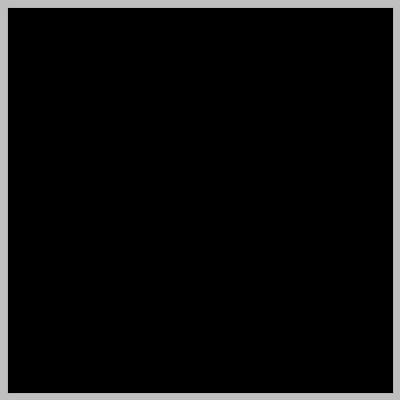

None


In [0]:
from matplotlib import pyplot

def visualize_feature(model):
  for layer in model.layers:
    # check for convolutional layer
    if 'res' not in layer.name:
      continue

    filters, biases = layer.get_weights()

    title = layer.name + " - " + str(filters.shape).replace("'", '')
    print(title)

    # normalize filter values to 0-1 so we can visualize them
    f_min, f_max = filters.min(), filters.max()
    filters = (filters - f_min) / (f_max - f_min)

    # plot first few filters
    n_filters, ix = 1, 1
    for i in range(n_filters):
      # get the filter
      f = filters[:, :, :, i]
      # plot each channel separately
      for j in range(1):
        # specify subplot and turn of axis
        ax = pyplot.subplot(n_filters, 1, ix)
        ax.set_xticks([])
        ax.set_yticks([])
        # plot filter channel in grayscale
        pyplot.imshow(f[:, :, j], cmap='gray')
        pyplot.savefig(PATH_VISUALIZE + "/feature/" + title + '.png')

        ix += 1
    # show the figure
    pyplot.show()

# model.summary()
print(visualize_feature(model))

res2a_branch2a - (1, 112, 112, 64)


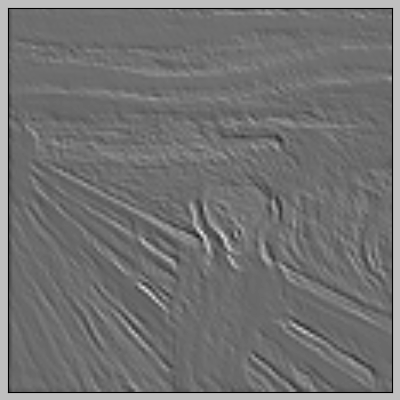

res2a_branch2a - (1, 64, 114, 114)


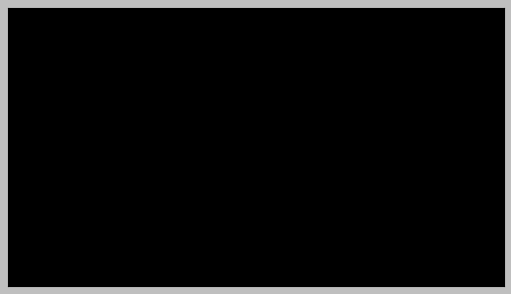

res2a_branch2a - (1, 56, 56, 64)


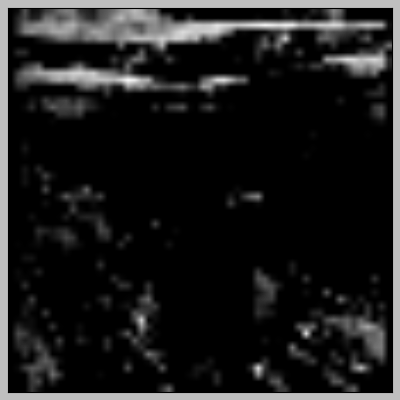

res2a_branch2a - (1, 56, 56, 256)


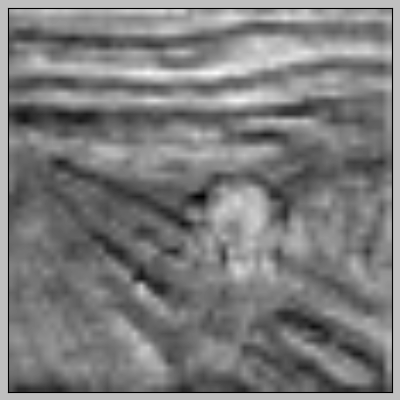

res2a_branch2a - (1, 56, 56, 256)


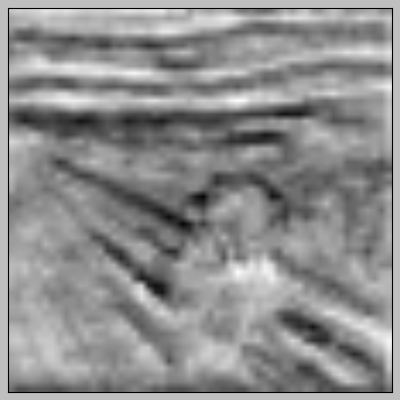

res2a_branch2b - (1, 112, 112, 64)


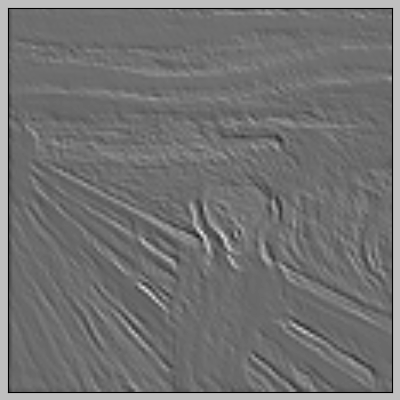

res2a_branch2b - (1, 64, 114, 114)


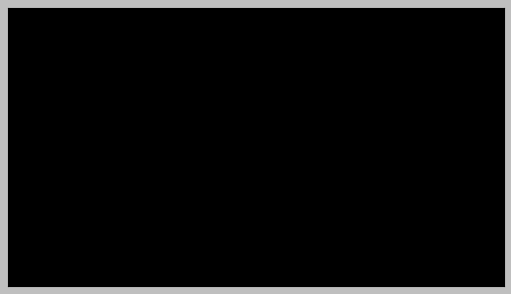

res2a_branch2b - (1, 56, 56, 64)


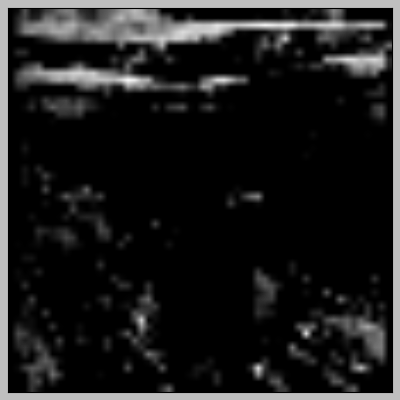

res2a_branch2b - (1, 56, 56, 256)


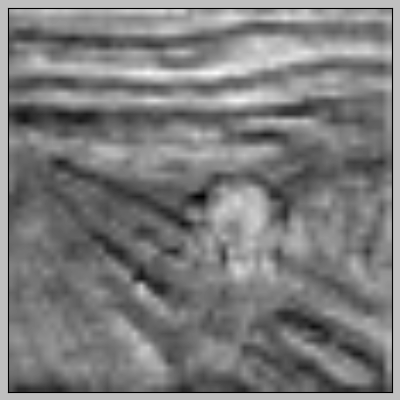

res2a_branch2b - (1, 56, 56, 256)


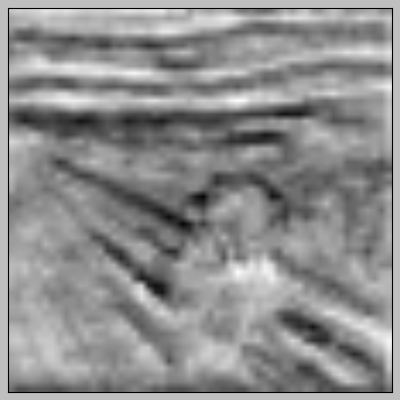

res2a_branch2c - (1, 112, 112, 64)


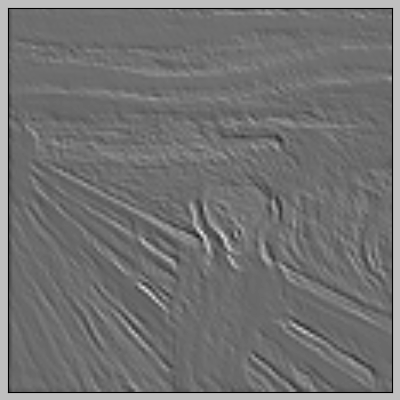

res2a_branch2c - (1, 64, 114, 114)


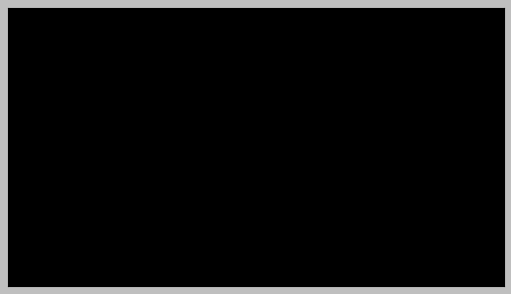

res2a_branch2c - (1, 56, 56, 64)


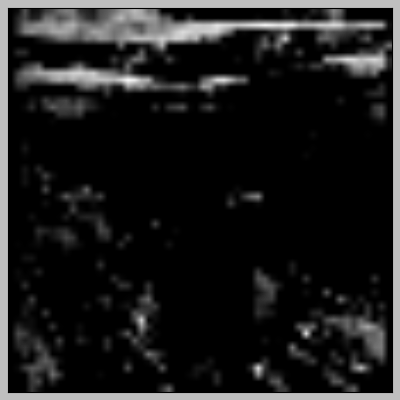

res2a_branch2c - (1, 56, 56, 256)


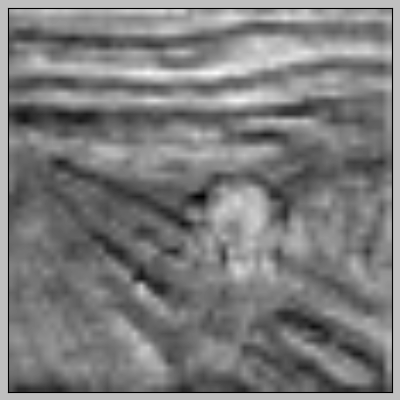

res2a_branch2c - (1, 56, 56, 256)


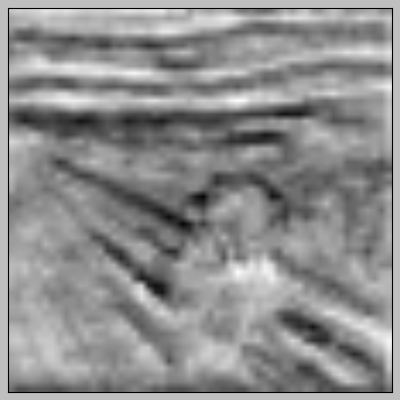

res2a_branch1 - (1, 112, 112, 64)


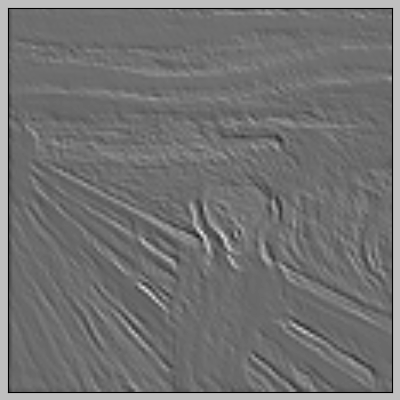

res2a_branch1 - (1, 64, 114, 114)


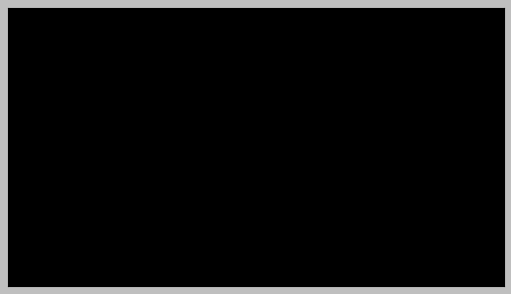

res2a_branch1 - (1, 56, 56, 64)


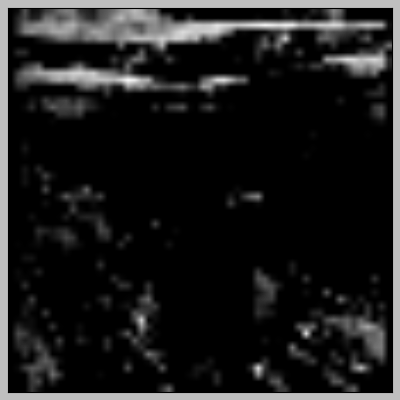

res2a_branch1 - (1, 56, 56, 256)


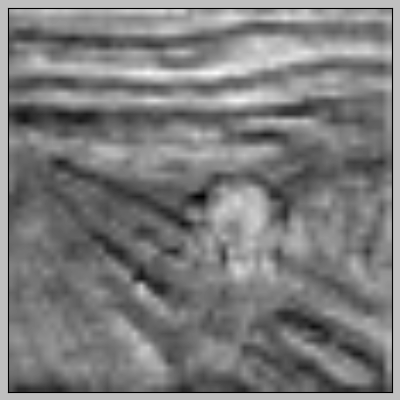

res2a_branch1 - (1, 56, 56, 256)


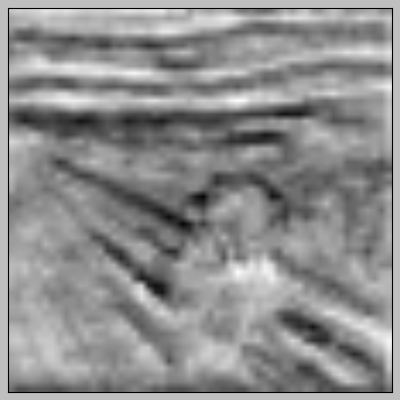

res2b_branch2a - (1, 112, 112, 64)


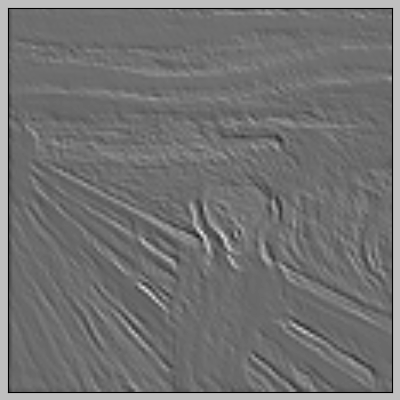

res2b_branch2a - (1, 64, 114, 114)


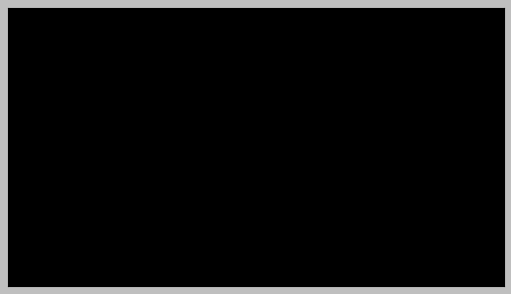

res2b_branch2a - (1, 56, 56, 64)


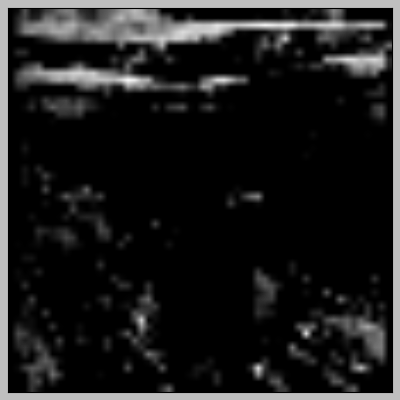

res2b_branch2a - (1, 56, 56, 256)


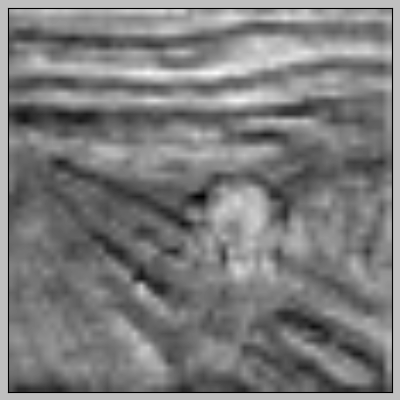

res2b_branch2a - (1, 56, 56, 256)


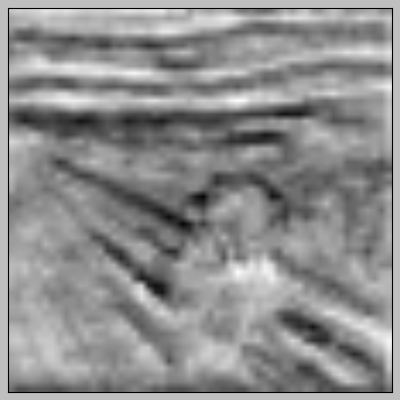

res2b_branch2b - (1, 112, 112, 64)


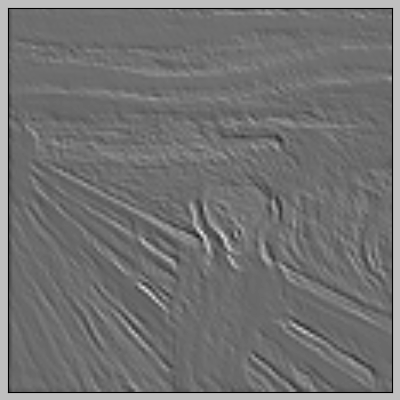

res2b_branch2b - (1, 64, 114, 114)


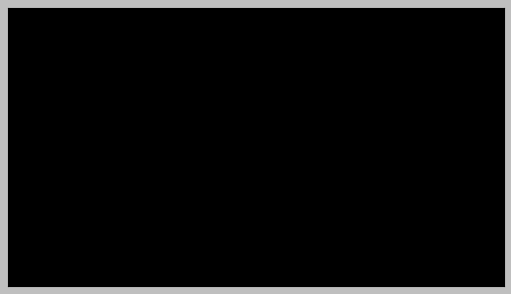

res2b_branch2b - (1, 56, 56, 64)


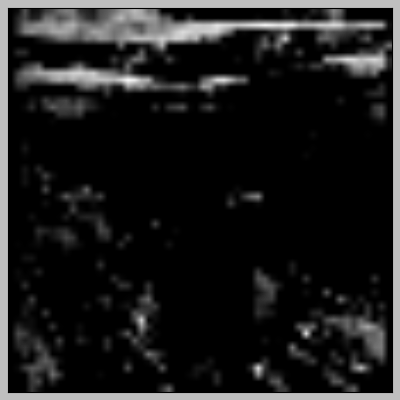

res2b_branch2b - (1, 56, 56, 256)


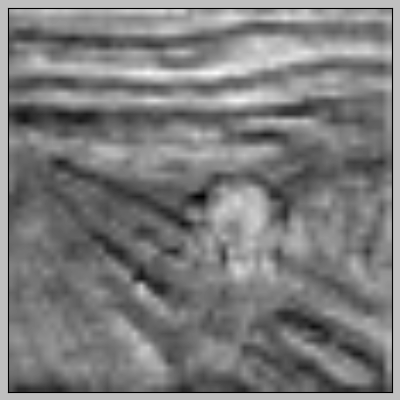

res2b_branch2b - (1, 56, 56, 256)


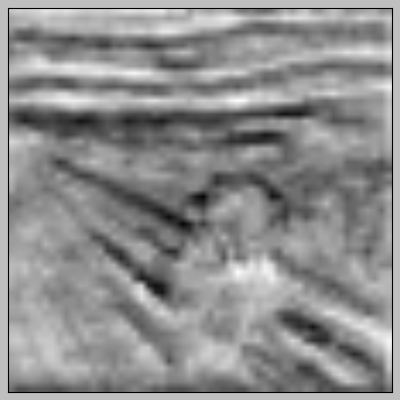

res2b_branch2c - (1, 112, 112, 64)


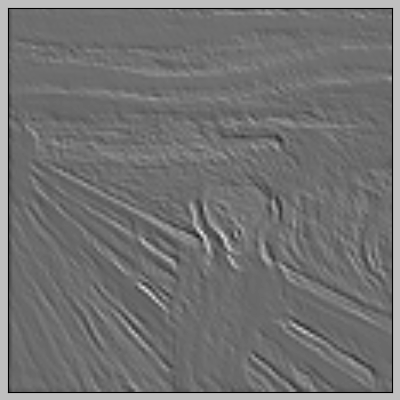

res2b_branch2c - (1, 64, 114, 114)


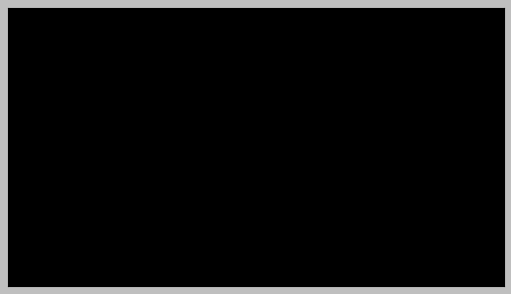

res2b_branch2c - (1, 56, 56, 64)


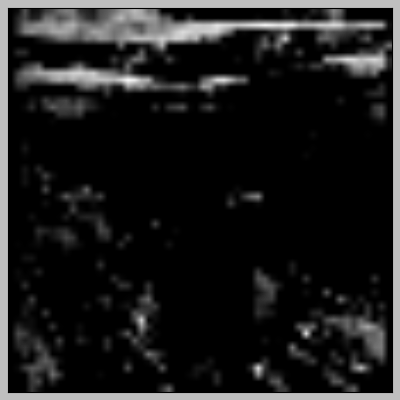

res2b_branch2c - (1, 56, 56, 256)


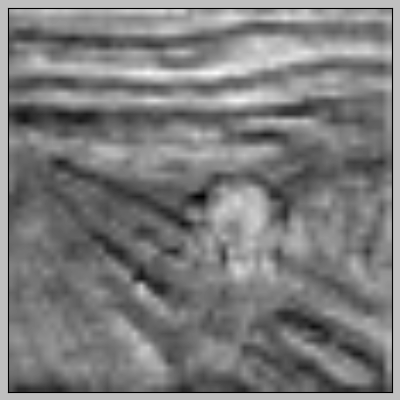

res2b_branch2c - (1, 56, 56, 256)


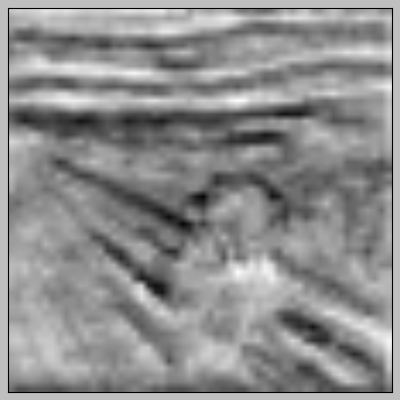

res2c_branch2a - (1, 112, 112, 64)


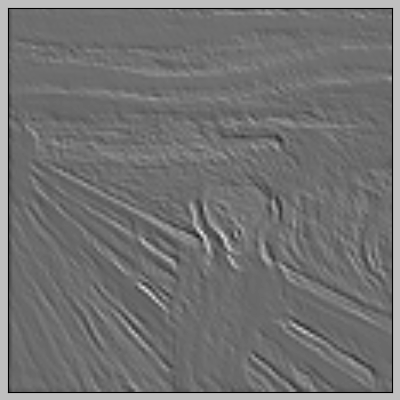

res2c_branch2a - (1, 64, 114, 114)


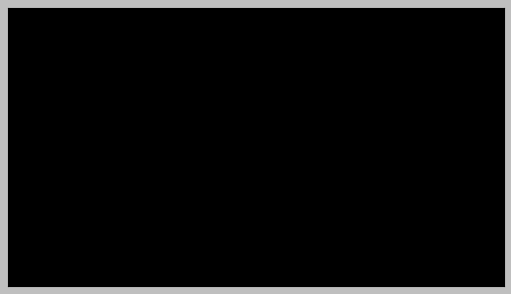

res2c_branch2a - (1, 56, 56, 64)


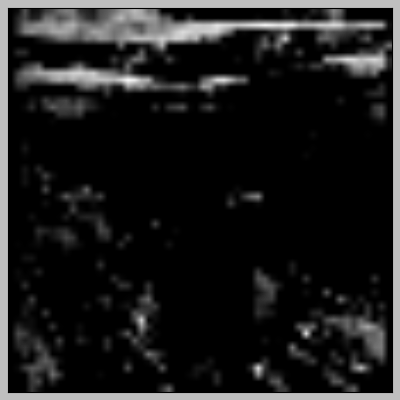

res2c_branch2a - (1, 56, 56, 256)


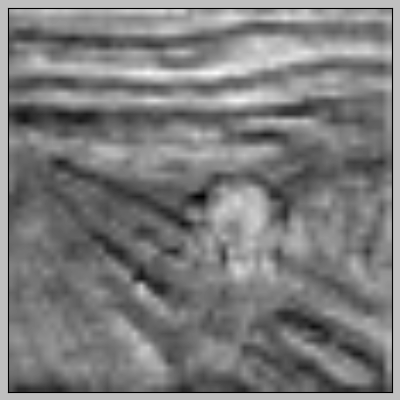

res2c_branch2a - (1, 56, 56, 256)


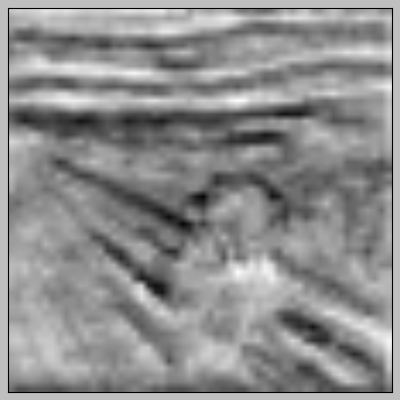

res2c_branch2b - (1, 112, 112, 64)


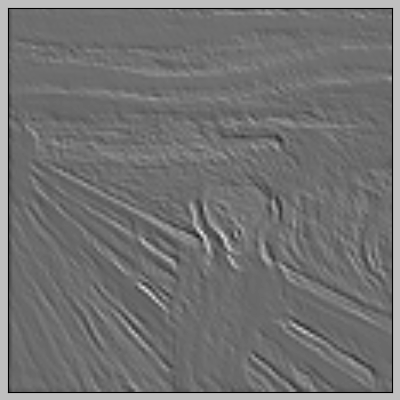

res2c_branch2b - (1, 64, 114, 114)


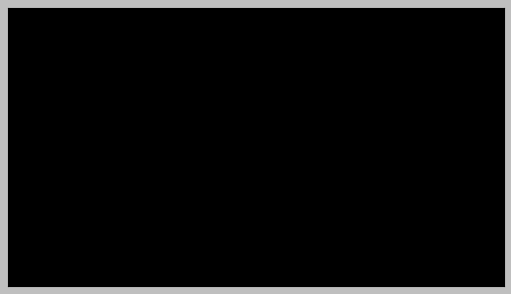

res2c_branch2b - (1, 56, 56, 64)


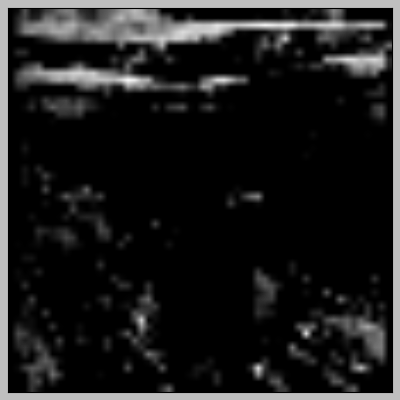

res2c_branch2b - (1, 56, 56, 256)


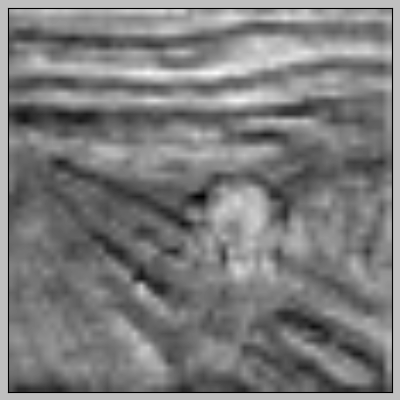

res2c_branch2b - (1, 56, 56, 256)


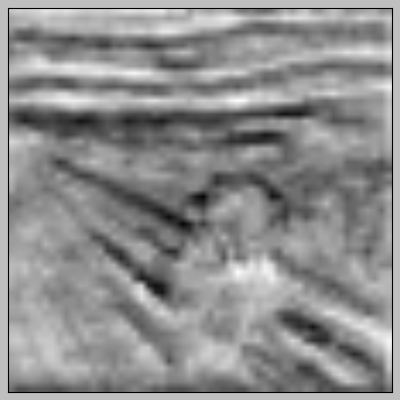

res2c_branch2c - (1, 112, 112, 64)


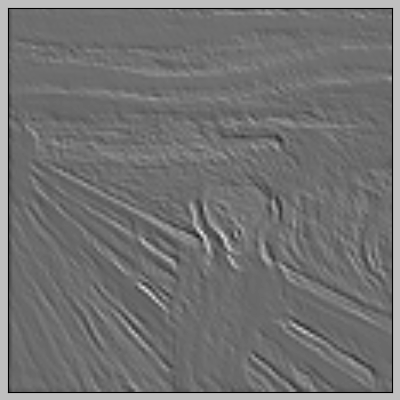

res2c_branch2c - (1, 64, 114, 114)


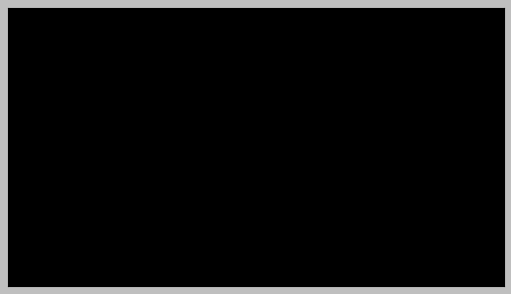

res2c_branch2c - (1, 56, 56, 64)


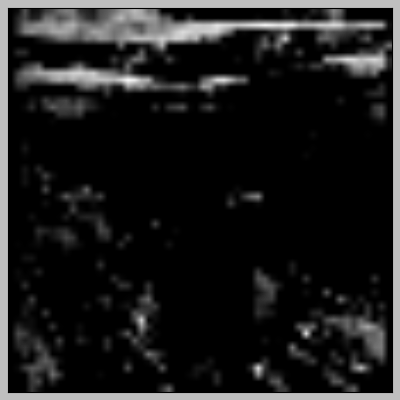

res2c_branch2c - (1, 56, 56, 256)


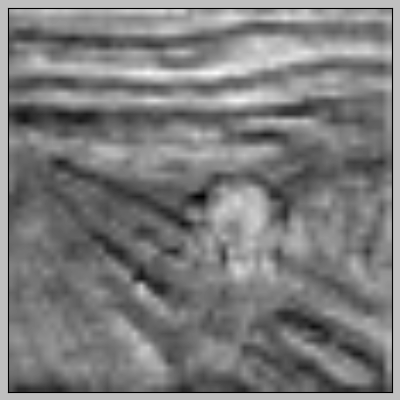

res2c_branch2c - (1, 56, 56, 256)


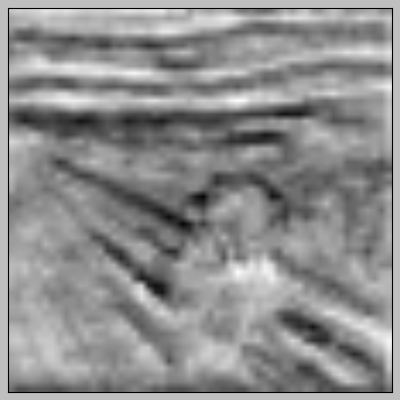

res3a_branch2a - (1, 112, 112, 64)


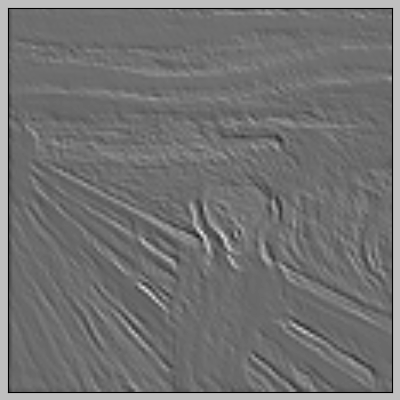

res3a_branch2a - (1, 64, 114, 114)


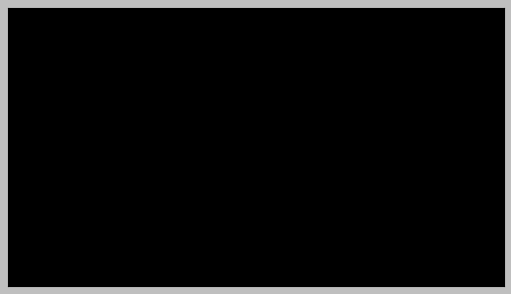

res3a_branch2a - (1, 56, 56, 64)


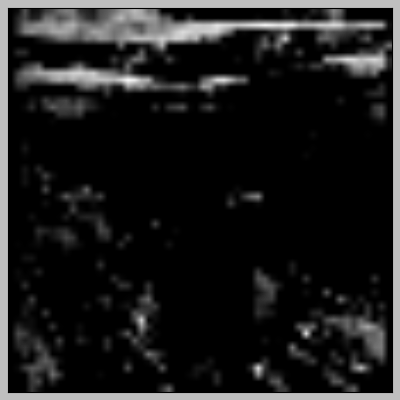

res3a_branch2a - (1, 56, 56, 256)


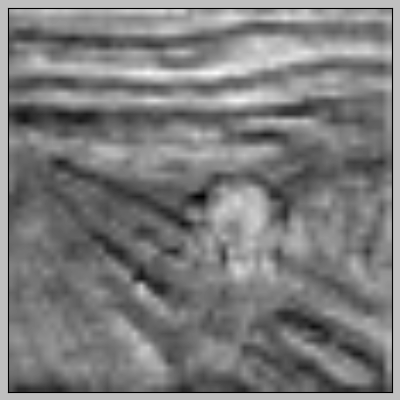

res3a_branch2a - (1, 56, 56, 256)


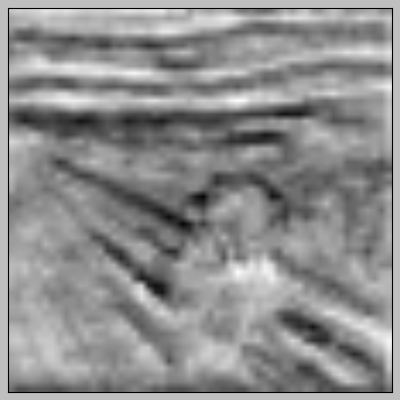

res3a_branch2b - (1, 112, 112, 64)


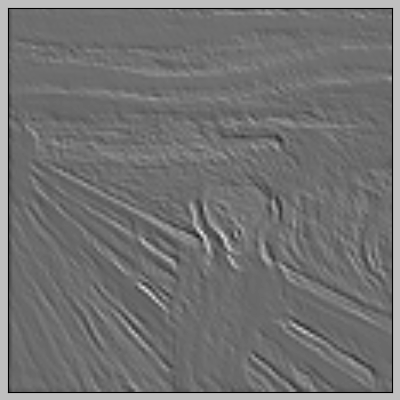

res3a_branch2b - (1, 64, 114, 114)


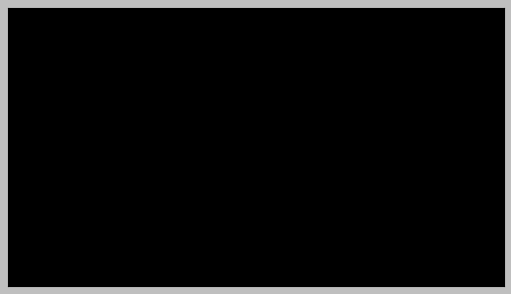

res3a_branch2b - (1, 56, 56, 64)


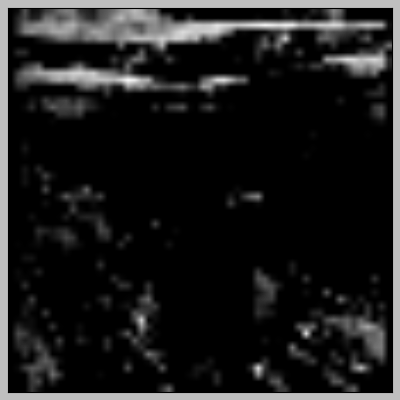

res3a_branch2b - (1, 56, 56, 256)


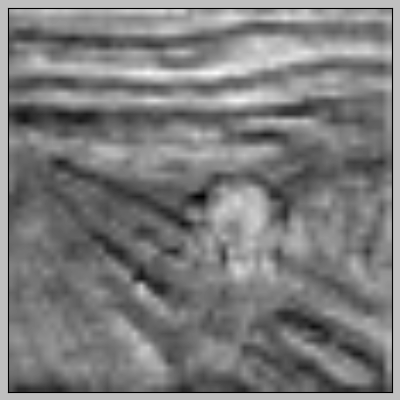

res3a_branch2b - (1, 56, 56, 256)


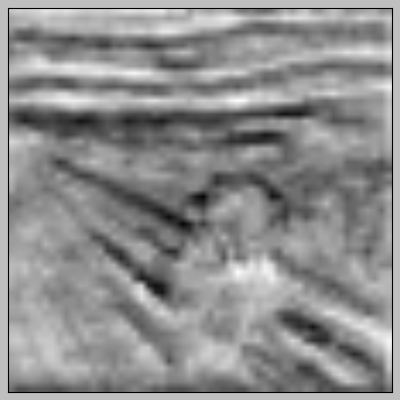

res3a_branch2c - (1, 112, 112, 64)


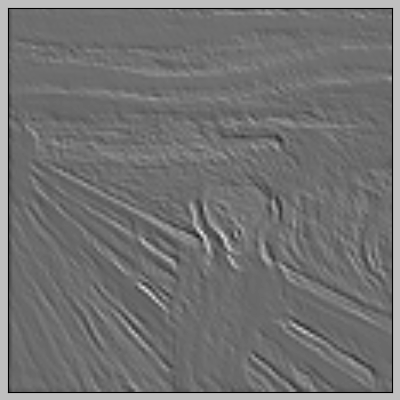

res3a_branch2c - (1, 64, 114, 114)


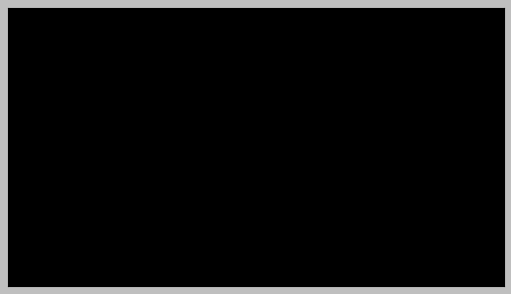

res3a_branch2c - (1, 56, 56, 64)


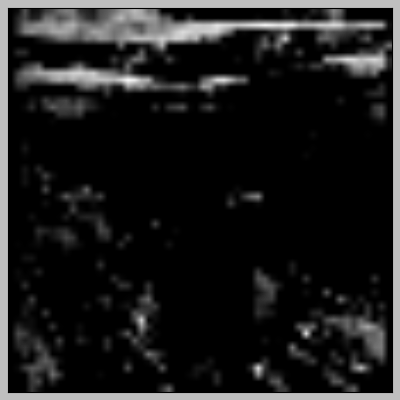

res3a_branch2c - (1, 56, 56, 256)


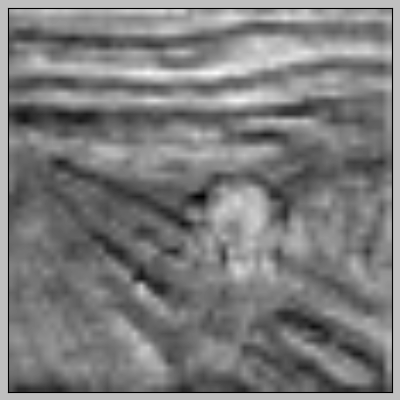

res3a_branch2c - (1, 56, 56, 256)


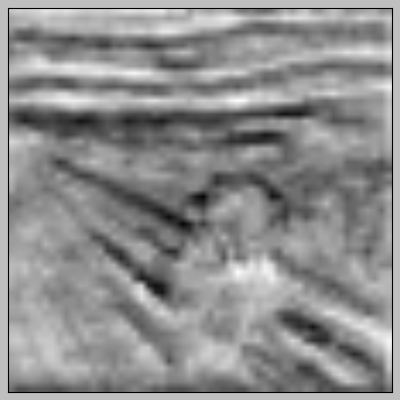

res3a_branch1 - (1, 112, 112, 64)


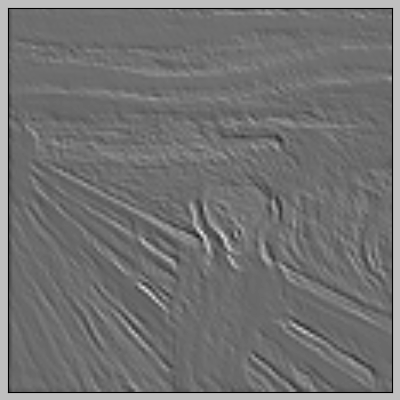

res3a_branch1 - (1, 64, 114, 114)


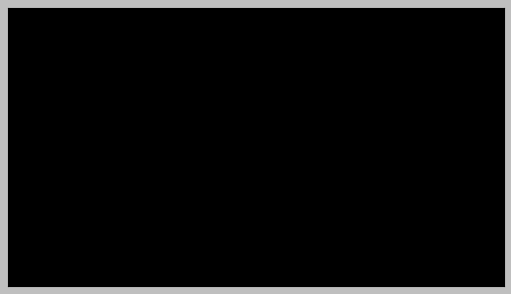

res3a_branch1 - (1, 56, 56, 64)


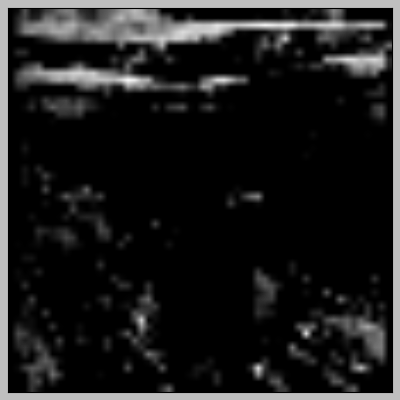

res3a_branch1 - (1, 56, 56, 256)


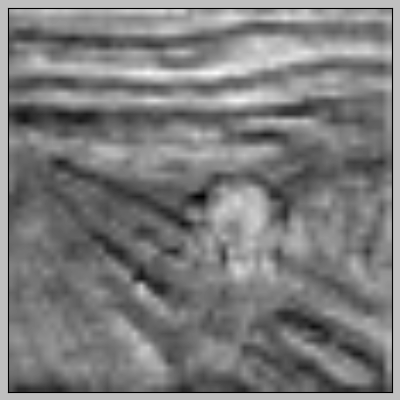

res3a_branch1 - (1, 56, 56, 256)


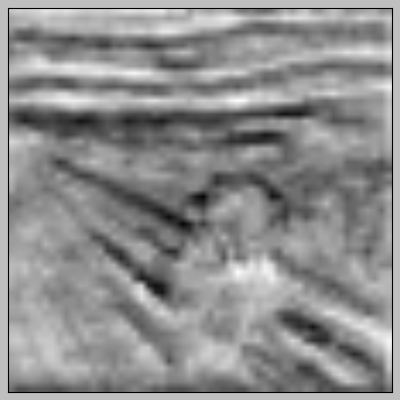

res3b_branch2a - (1, 112, 112, 64)


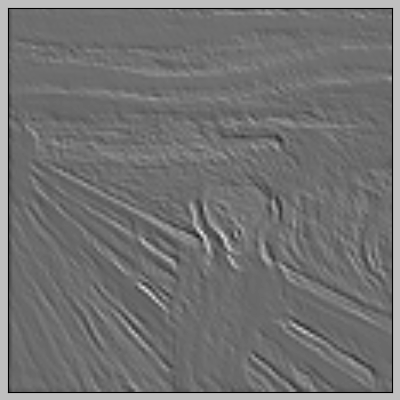

res3b_branch2a - (1, 64, 114, 114)


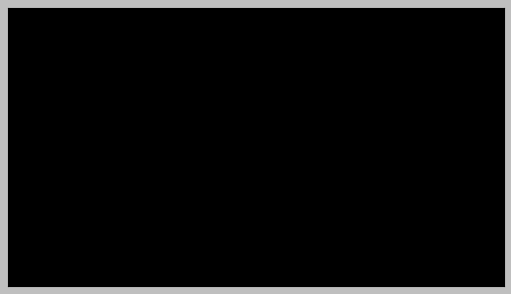

res3b_branch2a - (1, 56, 56, 64)


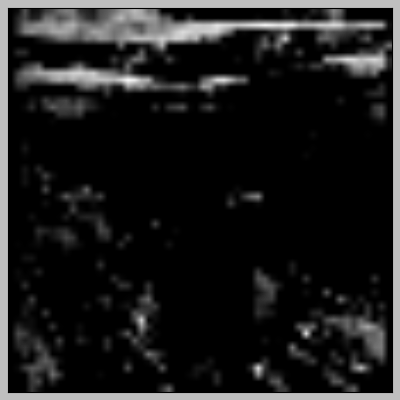

res3b_branch2a - (1, 56, 56, 256)


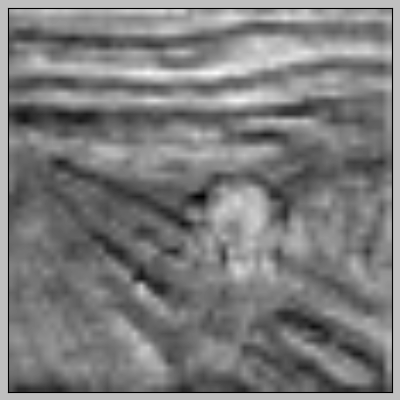

res3b_branch2a - (1, 56, 56, 256)


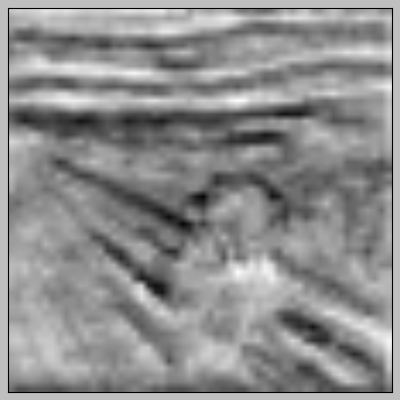

res3b_branch2b - (1, 112, 112, 64)


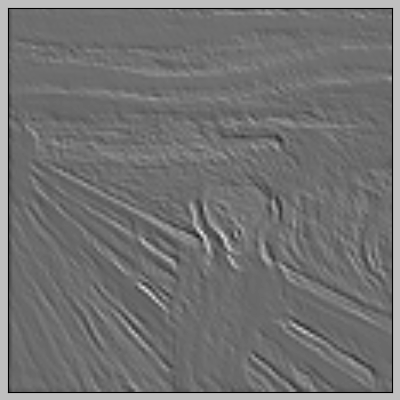

res3b_branch2b - (1, 64, 114, 114)


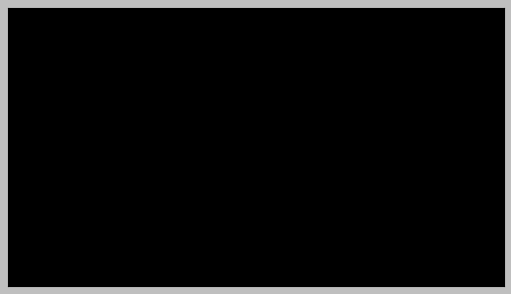

res3b_branch2b - (1, 56, 56, 64)


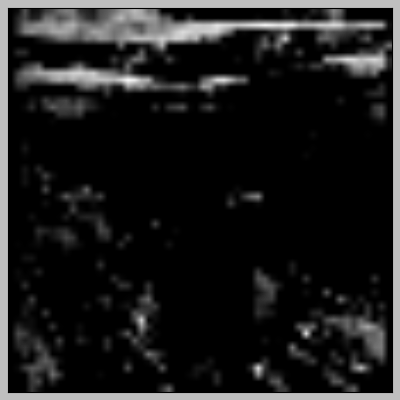

res3b_branch2b - (1, 56, 56, 256)


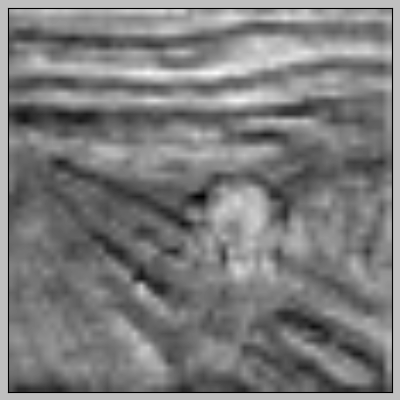

res3b_branch2b - (1, 56, 56, 256)


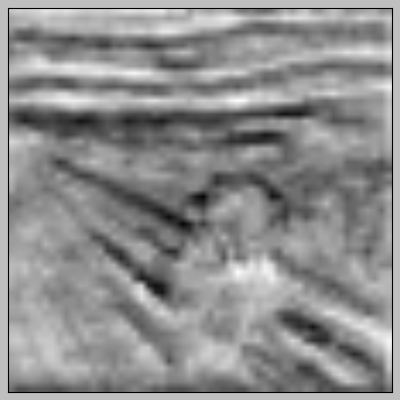

res3b_branch2c - (1, 112, 112, 64)


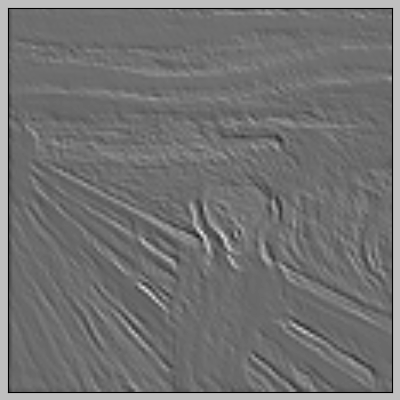

res3b_branch2c - (1, 64, 114, 114)


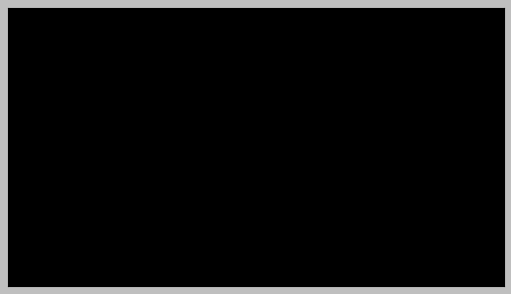

res3b_branch2c - (1, 56, 56, 64)


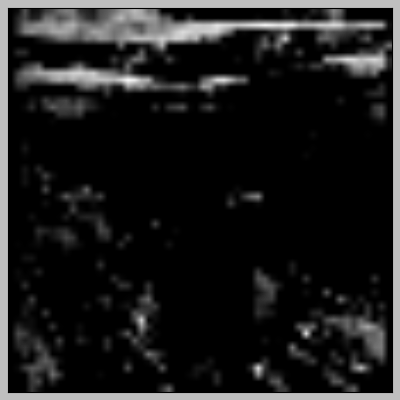

res3b_branch2c - (1, 56, 56, 256)


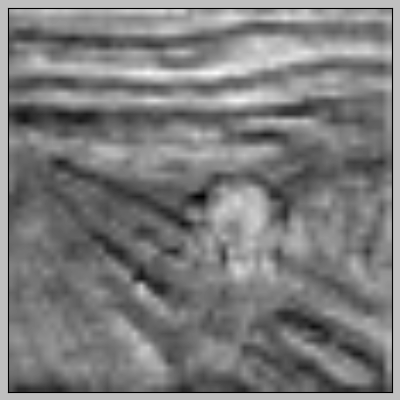

res3b_branch2c - (1, 56, 56, 256)


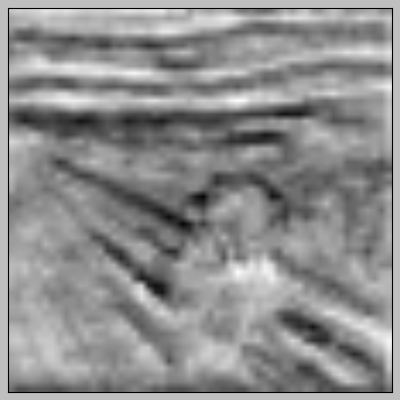

res3c_branch2a - (1, 112, 112, 64)


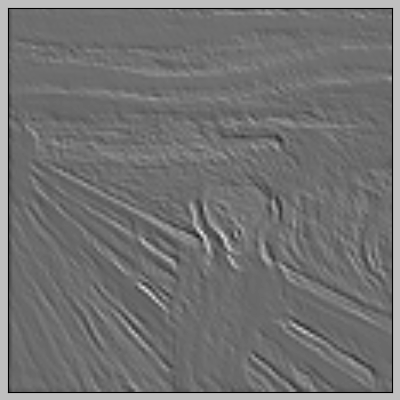

res3c_branch2a - (1, 64, 114, 114)


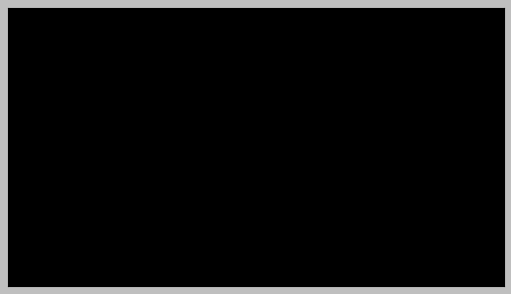

res3c_branch2a - (1, 56, 56, 64)


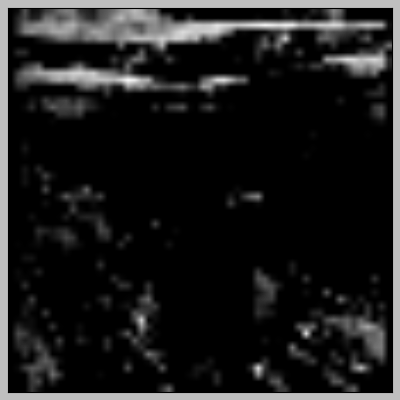

res3c_branch2a - (1, 56, 56, 256)


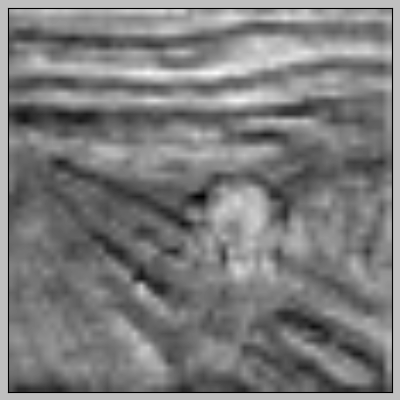

res3c_branch2a - (1, 56, 56, 256)


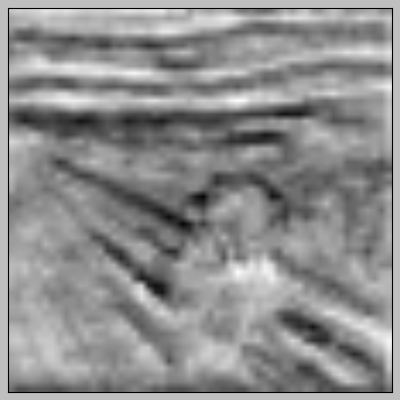

res3c_branch2b - (1, 112, 112, 64)


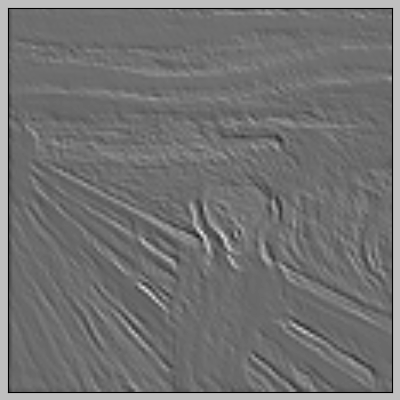

res3c_branch2b - (1, 64, 114, 114)


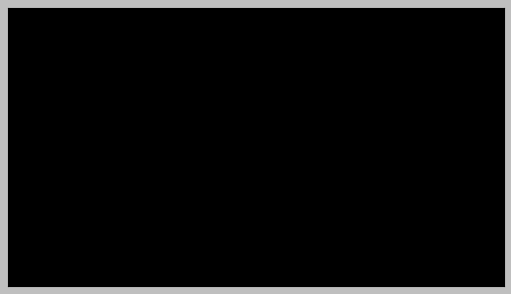

res3c_branch2b - (1, 56, 56, 64)


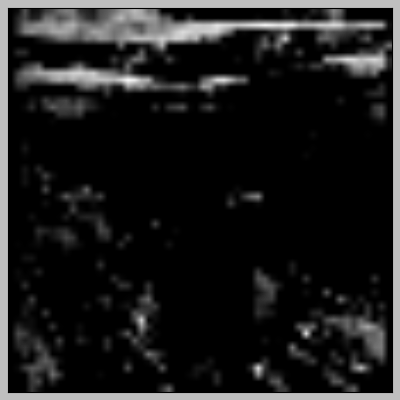

res3c_branch2b - (1, 56, 56, 256)


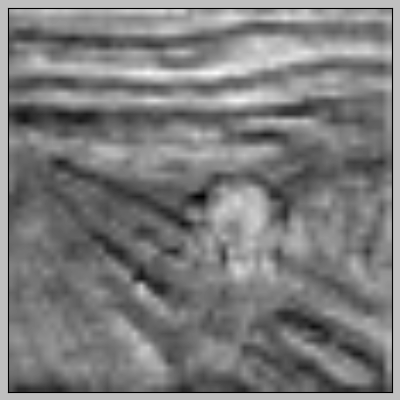

res3c_branch2b - (1, 56, 56, 256)


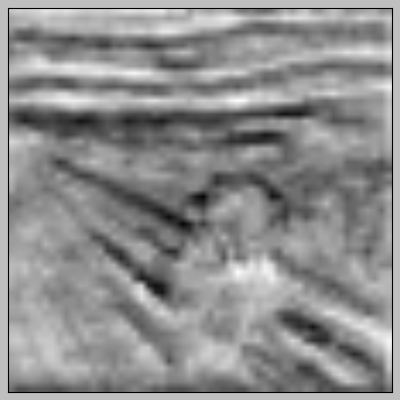

res3c_branch2c - (1, 112, 112, 64)


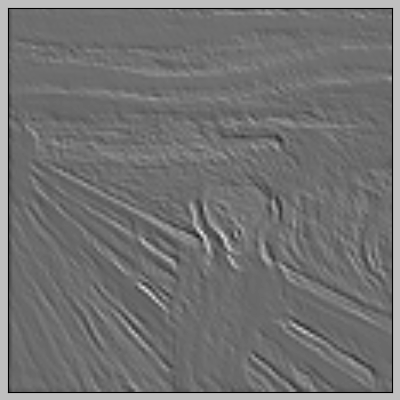

res3c_branch2c - (1, 64, 114, 114)


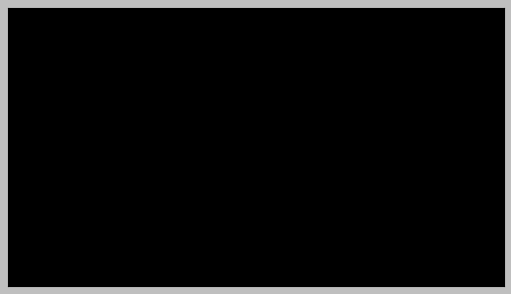

res3c_branch2c - (1, 56, 56, 64)


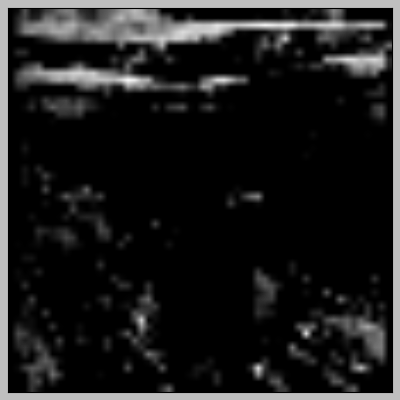

res3c_branch2c - (1, 56, 56, 256)


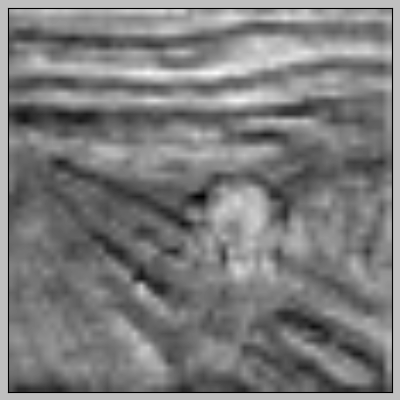

res3c_branch2c - (1, 56, 56, 256)


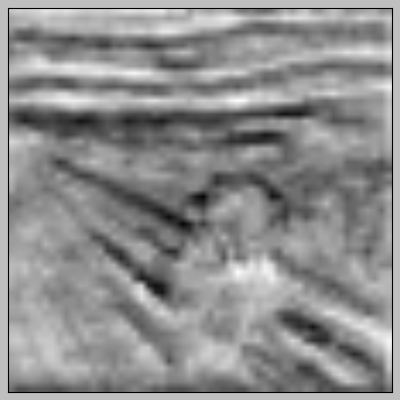

res3d_branch2a - (1, 112, 112, 64)


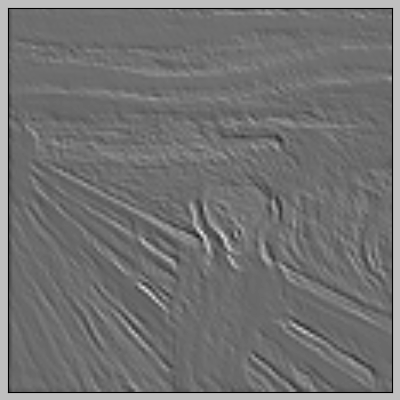

res3d_branch2a - (1, 64, 114, 114)


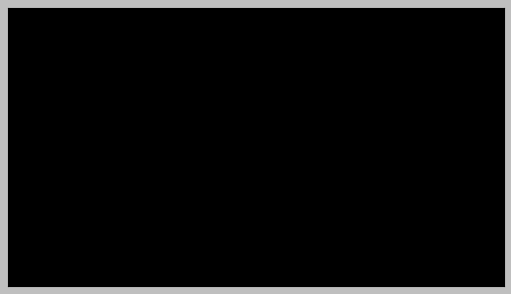

res3d_branch2a - (1, 56, 56, 64)


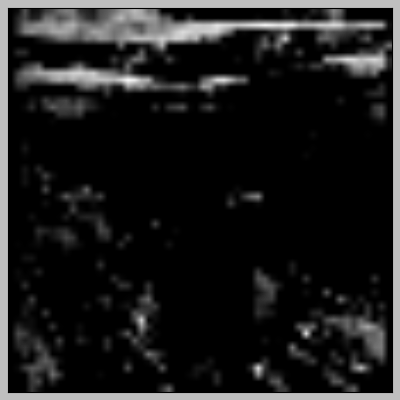

res3d_branch2a - (1, 56, 56, 256)


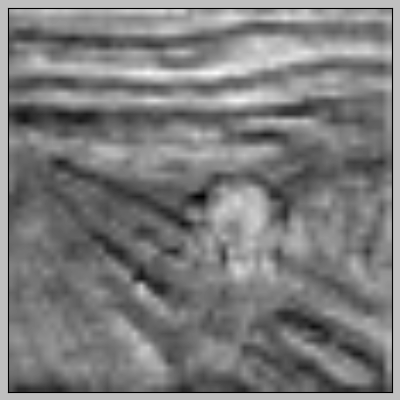

res3d_branch2a - (1, 56, 56, 256)


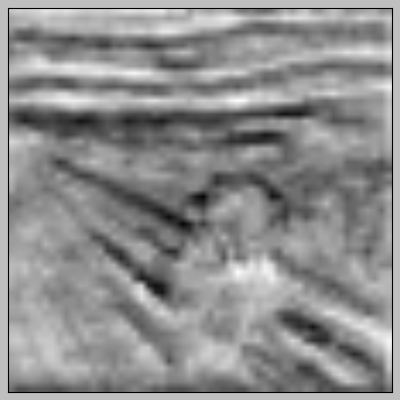

res3d_branch2b - (1, 112, 112, 64)


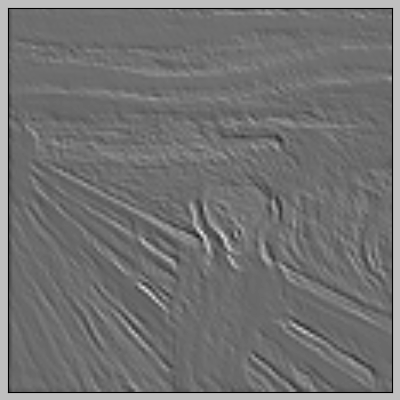

res3d_branch2b - (1, 64, 114, 114)


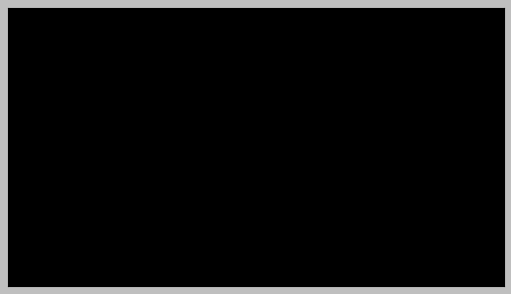

res3d_branch2b - (1, 56, 56, 64)


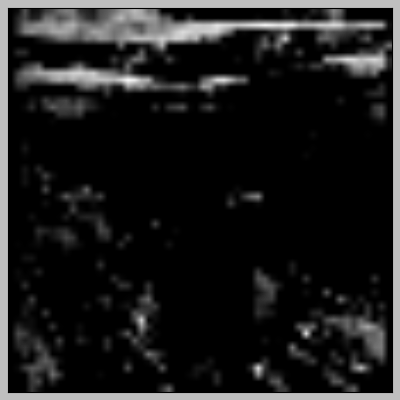

res3d_branch2b - (1, 56, 56, 256)


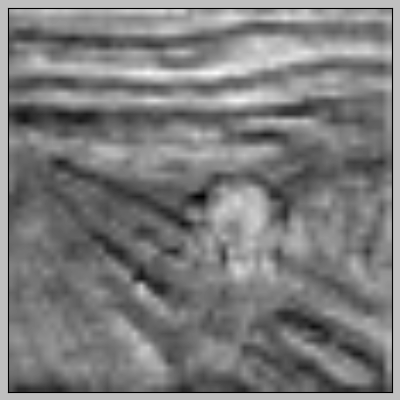

res3d_branch2b - (1, 56, 56, 256)


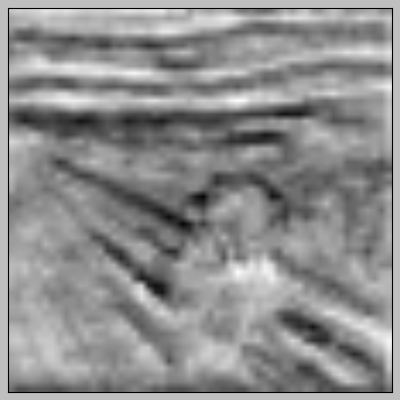

res3d_branch2c - (1, 112, 112, 64)


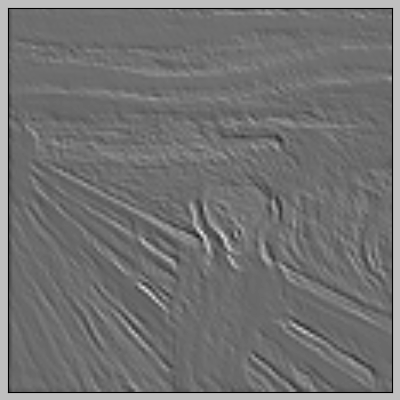

res3d_branch2c - (1, 64, 114, 114)


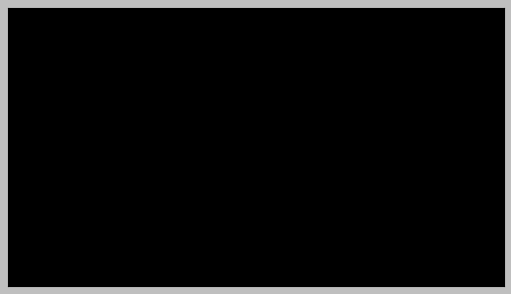

res3d_branch2c - (1, 56, 56, 64)


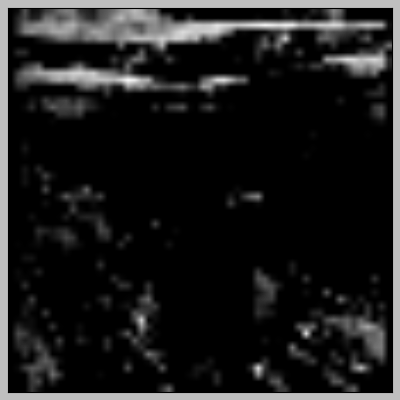

res3d_branch2c - (1, 56, 56, 256)


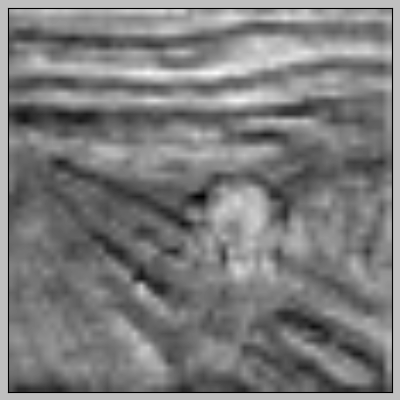

res3d_branch2c - (1, 56, 56, 256)


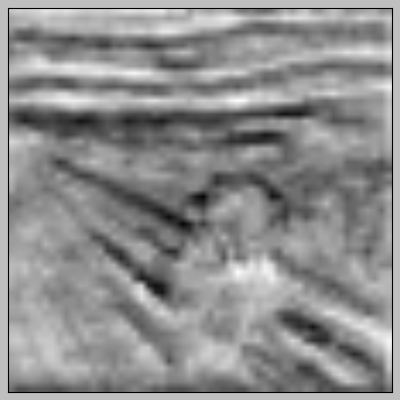

res4a_branch2a - (1, 112, 112, 64)


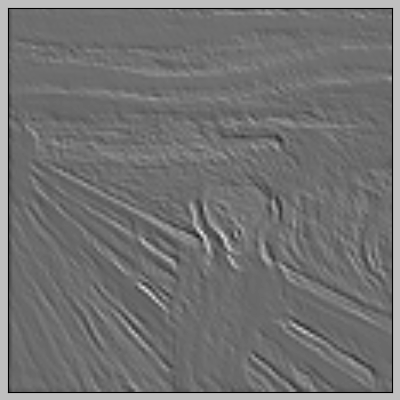

res4a_branch2a - (1, 64, 114, 114)


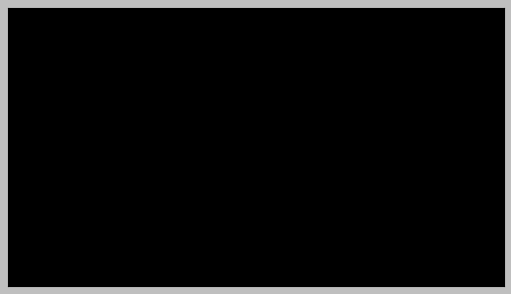

res4a_branch2a - (1, 56, 56, 64)


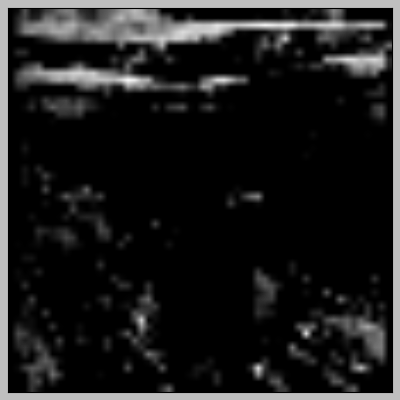

res4a_branch2a - (1, 56, 56, 256)


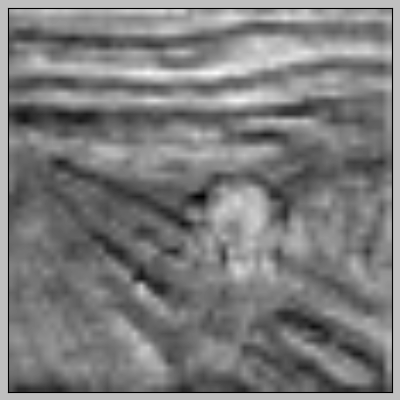

res4a_branch2a - (1, 56, 56, 256)


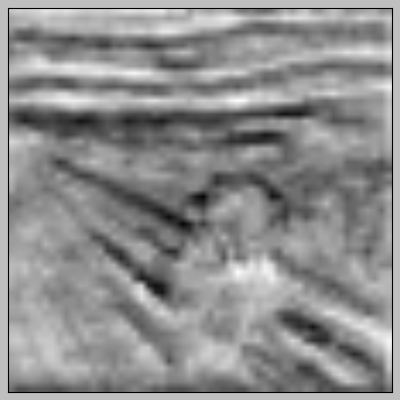

res4a_branch2b - (1, 112, 112, 64)


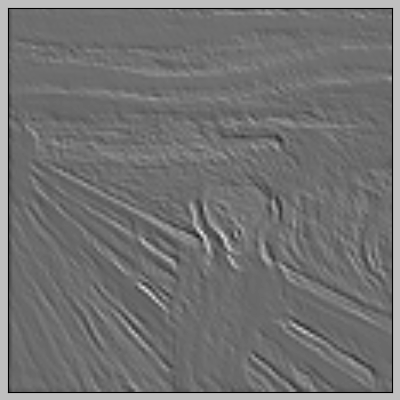

res4a_branch2b - (1, 64, 114, 114)


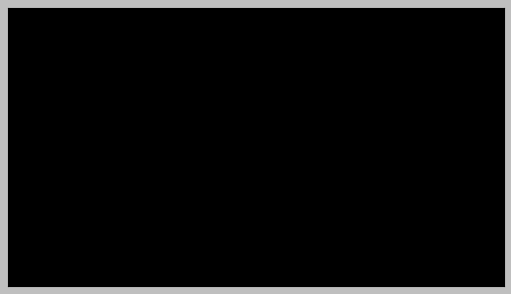

res4a_branch2b - (1, 56, 56, 64)


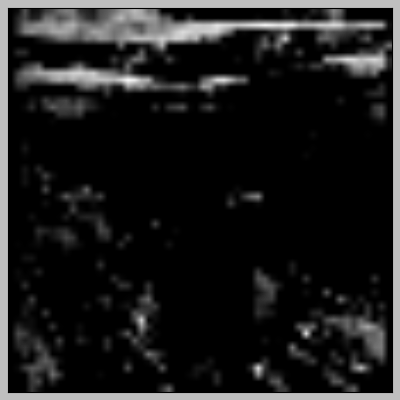

res4a_branch2b - (1, 56, 56, 256)


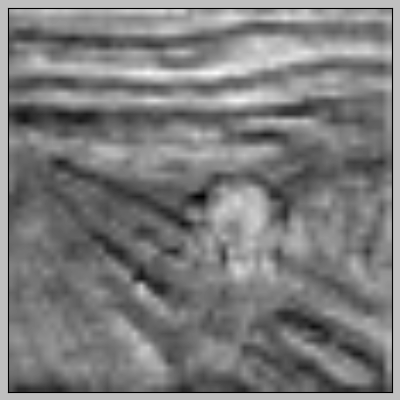

res4a_branch2b - (1, 56, 56, 256)


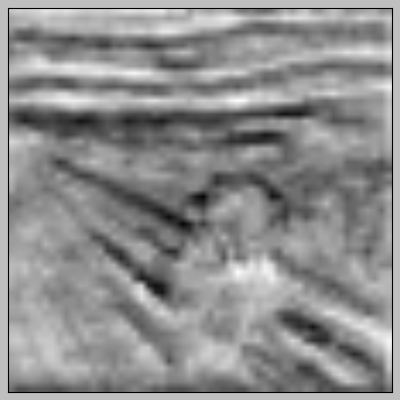

res4a_branch2c - (1, 112, 112, 64)


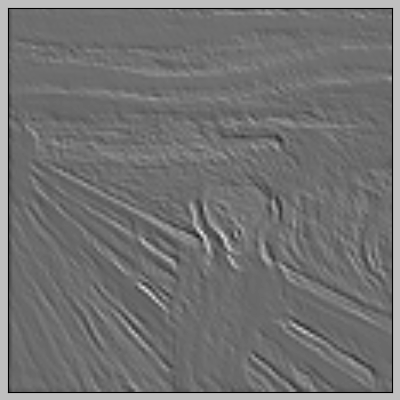

res4a_branch2c - (1, 64, 114, 114)


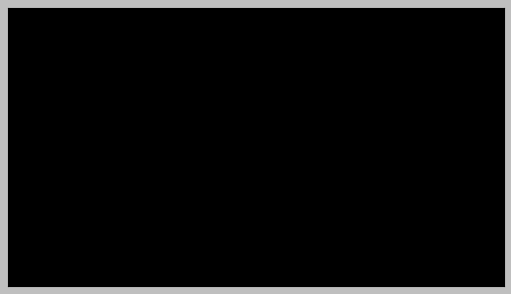

res4a_branch2c - (1, 56, 56, 64)


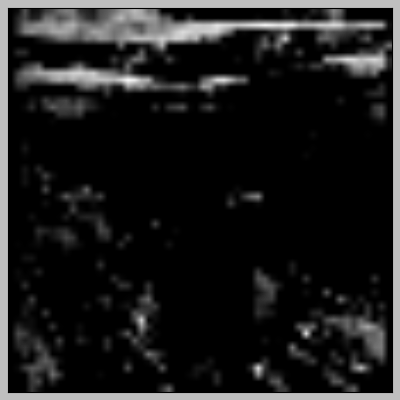

res4a_branch2c - (1, 56, 56, 256)


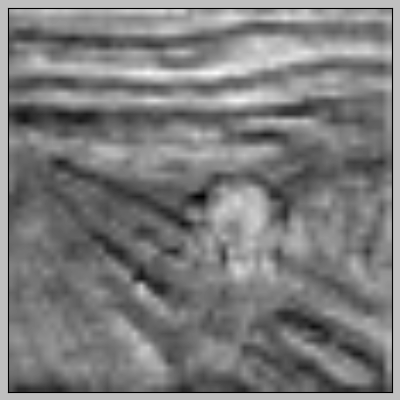

res4a_branch2c - (1, 56, 56, 256)


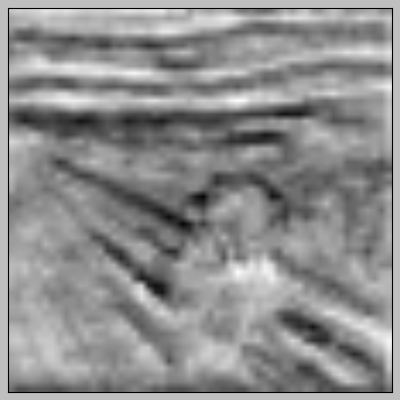

res4a_branch1 - (1, 112, 112, 64)


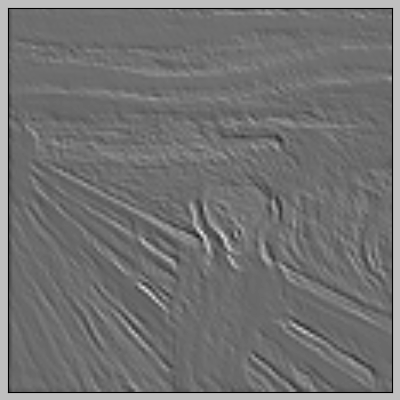

res4a_branch1 - (1, 64, 114, 114)


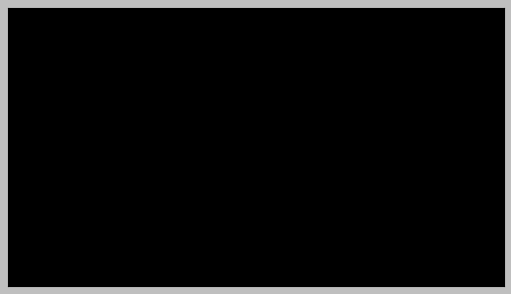

res4a_branch1 - (1, 56, 56, 64)


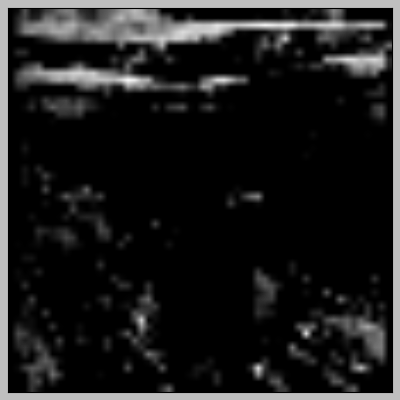

res4a_branch1 - (1, 56, 56, 256)


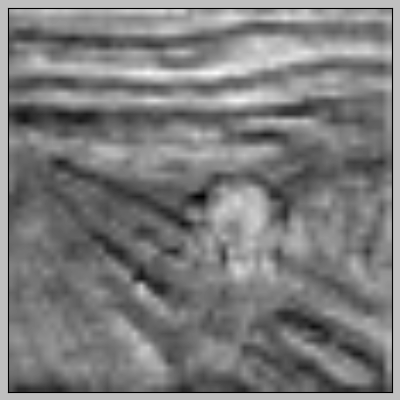

res4a_branch1 - (1, 56, 56, 256)


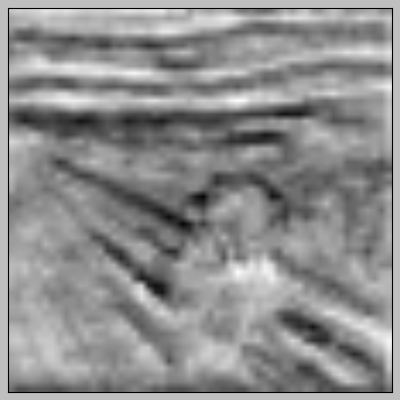

res4b_branch2a - (1, 112, 112, 64)


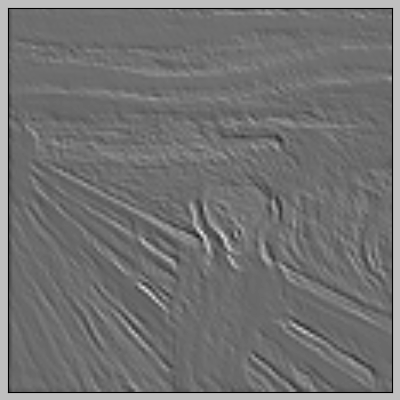

res4b_branch2a - (1, 64, 114, 114)


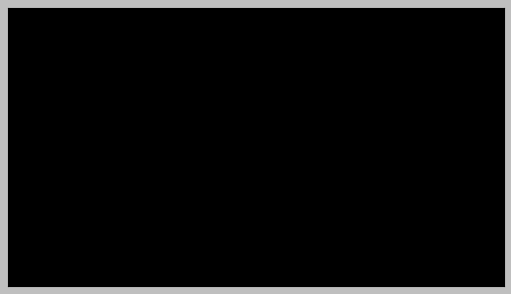

res4b_branch2a - (1, 56, 56, 64)


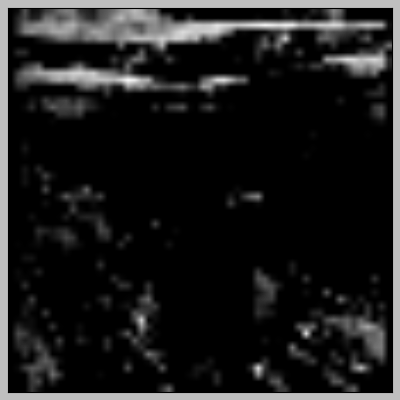

res4b_branch2a - (1, 56, 56, 256)


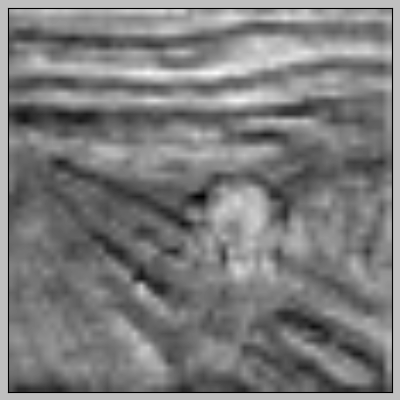

res4b_branch2a - (1, 56, 56, 256)


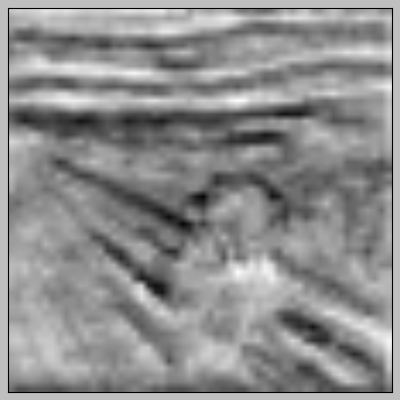

res4b_branch2b - (1, 112, 112, 64)


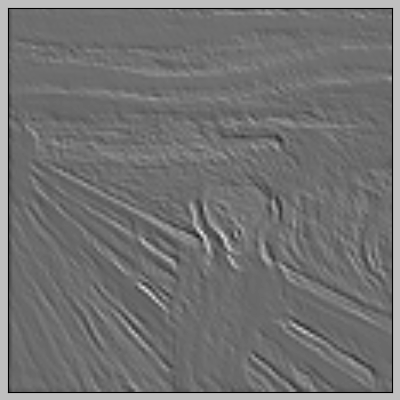

res4b_branch2b - (1, 64, 114, 114)


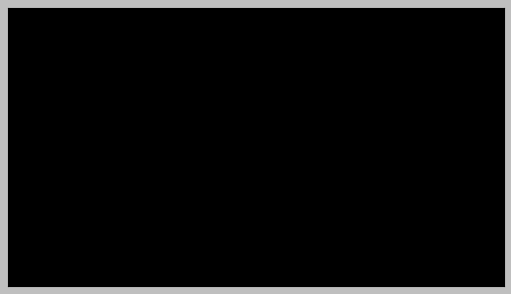

res4b_branch2b - (1, 56, 56, 64)


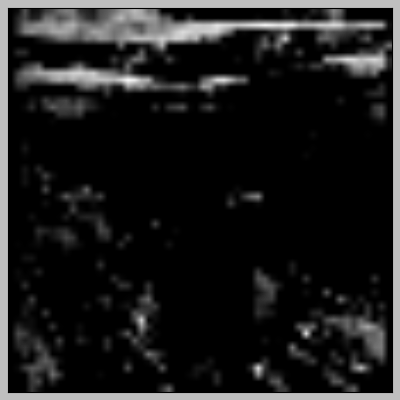

res4b_branch2b - (1, 56, 56, 256)


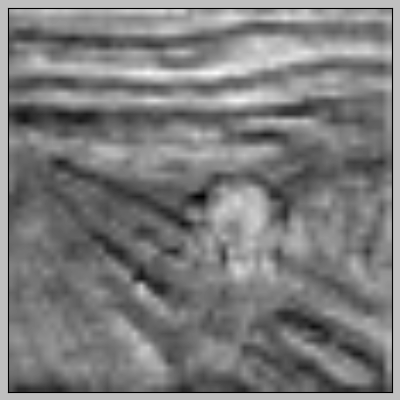

res4b_branch2b - (1, 56, 56, 256)


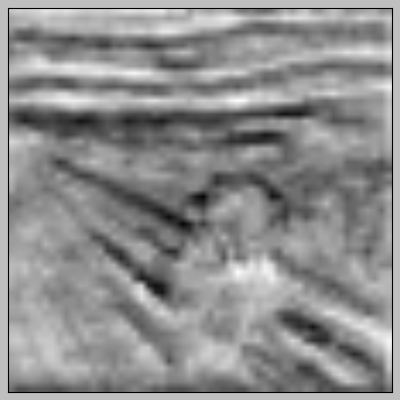

res4b_branch2c - (1, 112, 112, 64)


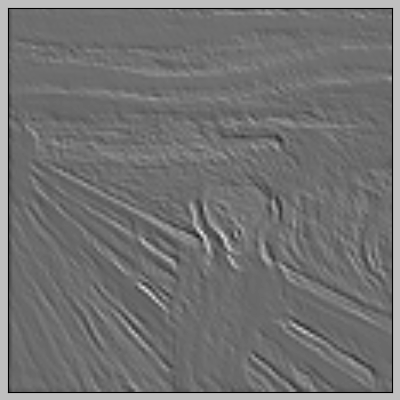

res4b_branch2c - (1, 64, 114, 114)


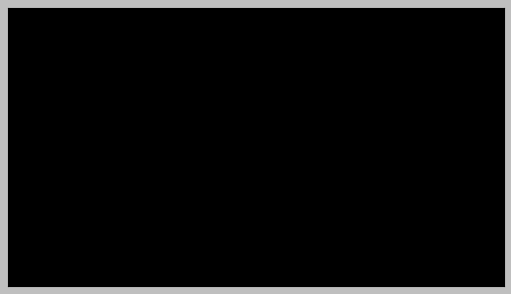

res4b_branch2c - (1, 56, 56, 64)


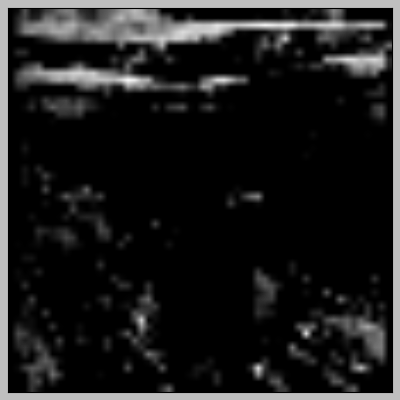

res4b_branch2c - (1, 56, 56, 256)


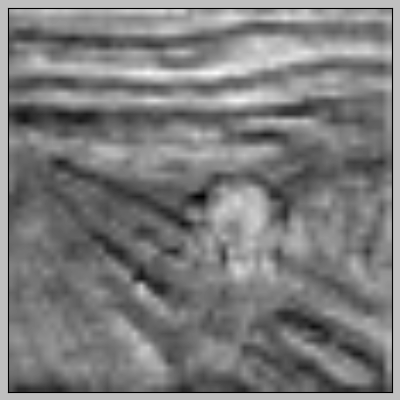

res4b_branch2c - (1, 56, 56, 256)


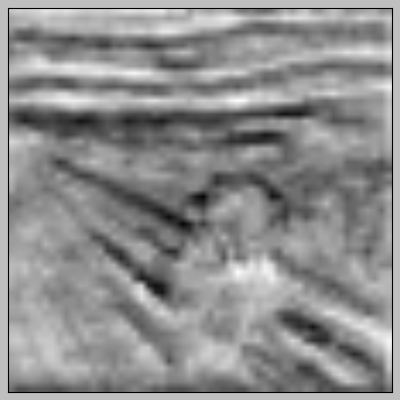

res4c_branch2a - (1, 112, 112, 64)


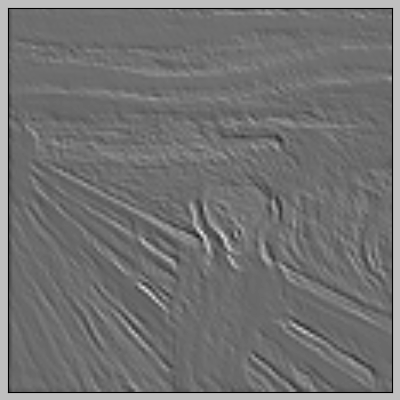

res4c_branch2a - (1, 64, 114, 114)


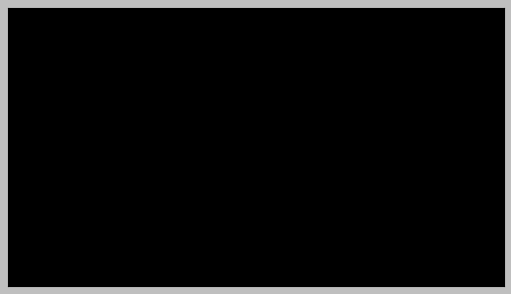

res4c_branch2a - (1, 56, 56, 64)


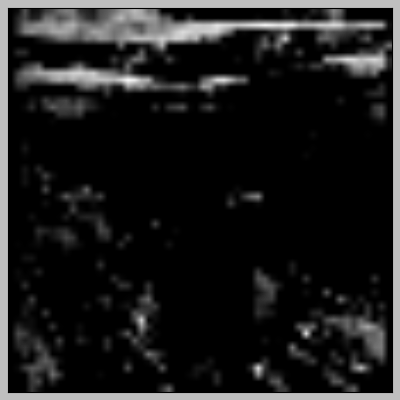

res4c_branch2a - (1, 56, 56, 256)


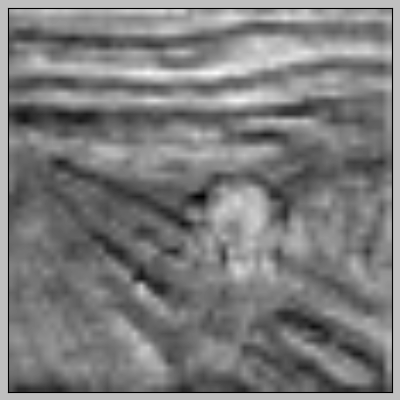

res4c_branch2a - (1, 56, 56, 256)


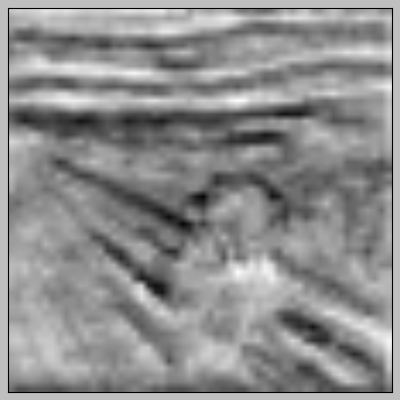

res4c_branch2b - (1, 112, 112, 64)


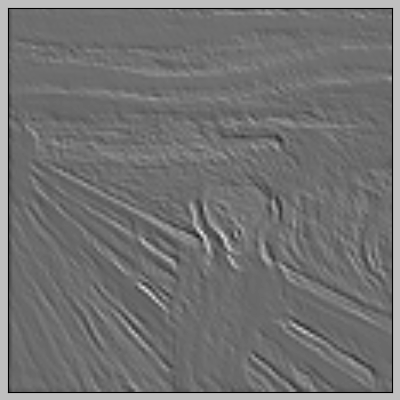

res4c_branch2b - (1, 64, 114, 114)


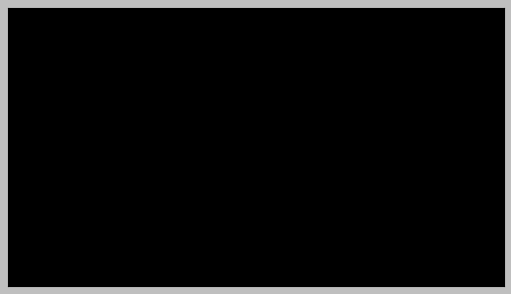

res4c_branch2b - (1, 56, 56, 64)


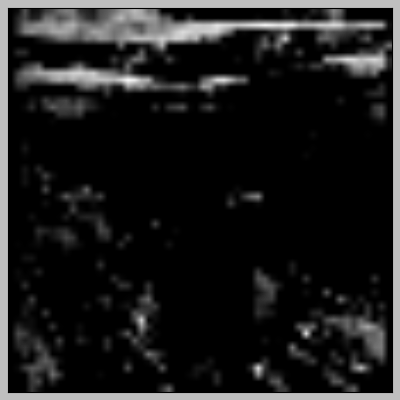

res4c_branch2b - (1, 56, 56, 256)


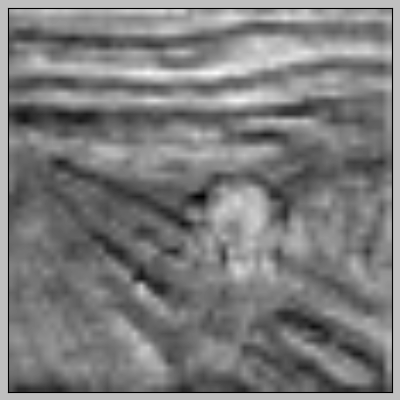

res4c_branch2b - (1, 56, 56, 256)


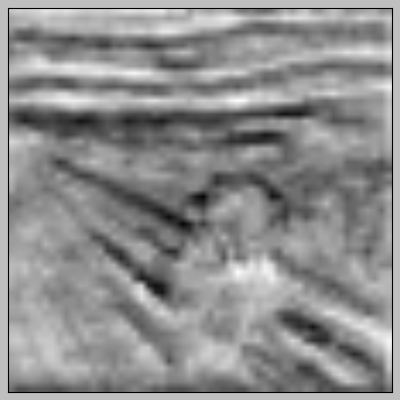

res4c_branch2c - (1, 112, 112, 64)


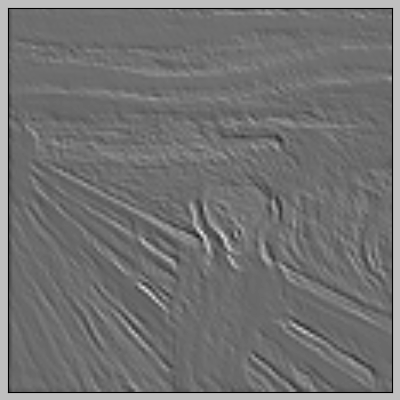

res4c_branch2c - (1, 64, 114, 114)


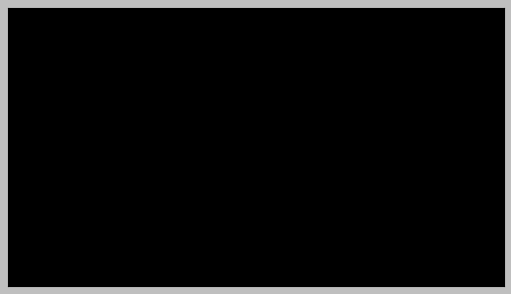

res4c_branch2c - (1, 56, 56, 64)


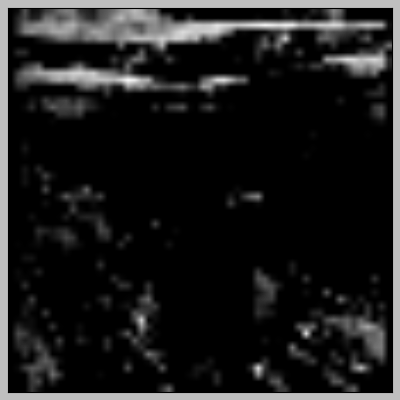

res4c_branch2c - (1, 56, 56, 256)


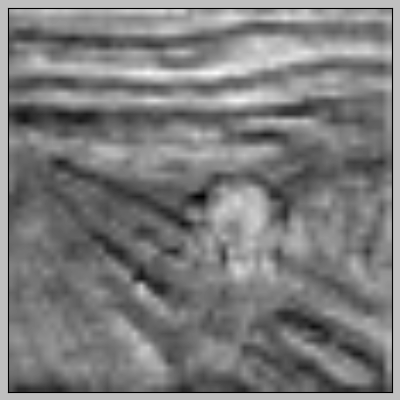

res4c_branch2c - (1, 56, 56, 256)


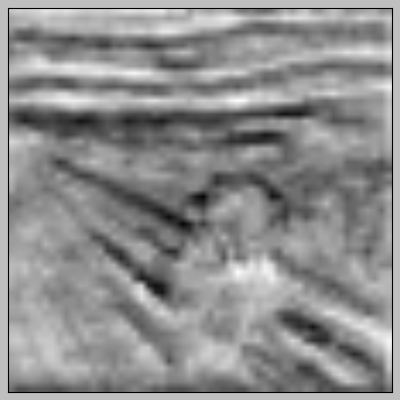

res4d_branch2a - (1, 112, 112, 64)


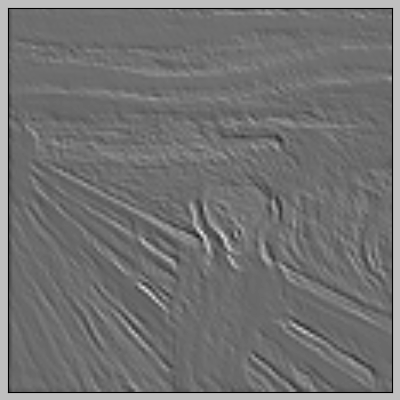

res4d_branch2a - (1, 64, 114, 114)


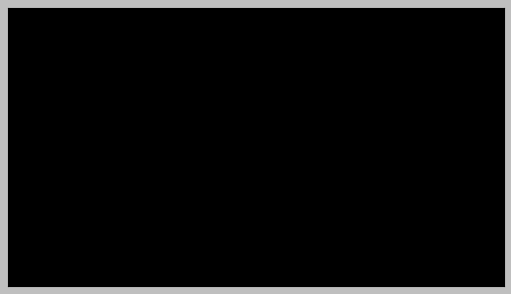

res4d_branch2a - (1, 56, 56, 64)


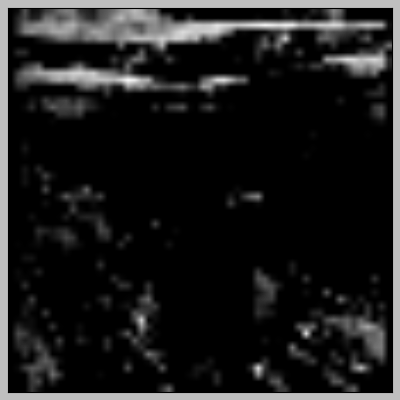

res4d_branch2a - (1, 56, 56, 256)


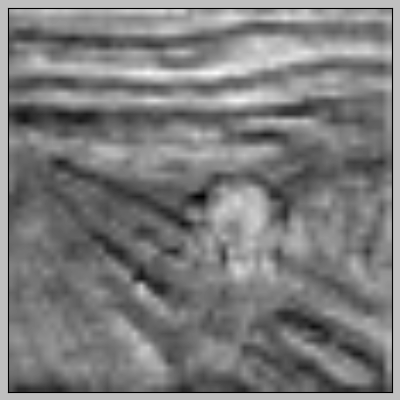

res4d_branch2a - (1, 56, 56, 256)


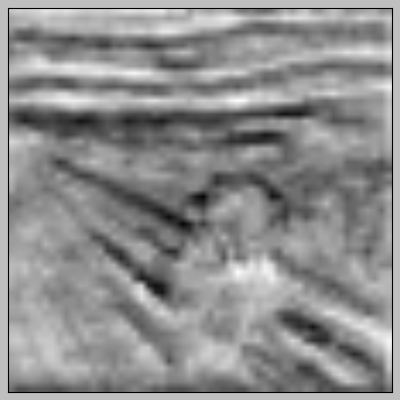

res4d_branch2b - (1, 112, 112, 64)


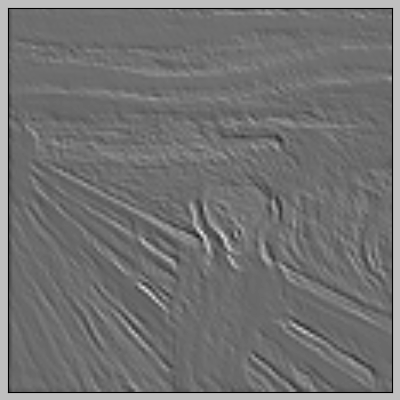

res4d_branch2b - (1, 64, 114, 114)


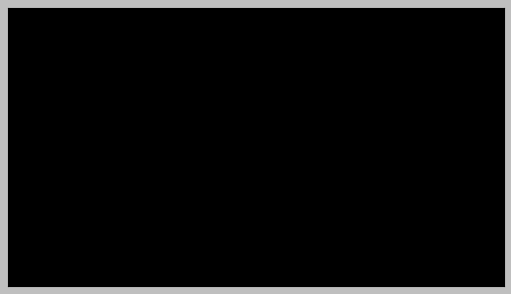

res4d_branch2b - (1, 56, 56, 64)


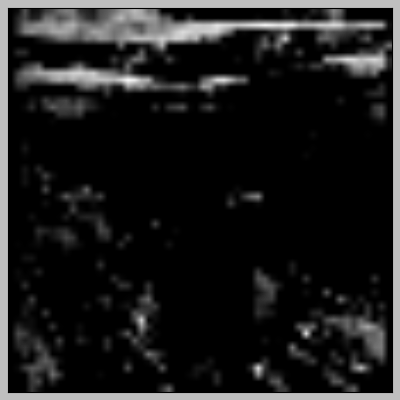

res4d_branch2b - (1, 56, 56, 256)


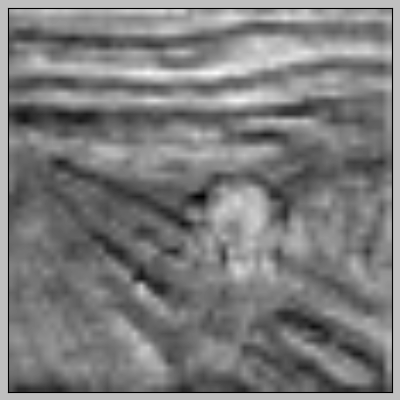

res4d_branch2b - (1, 56, 56, 256)


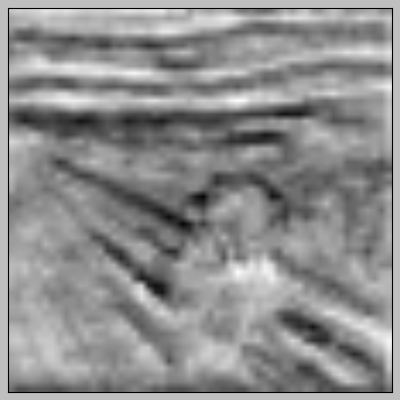

res4d_branch2c - (1, 112, 112, 64)


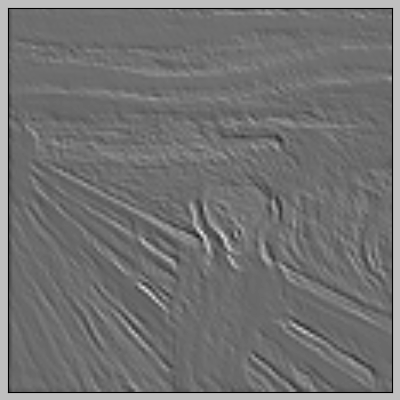

res4d_branch2c - (1, 64, 114, 114)


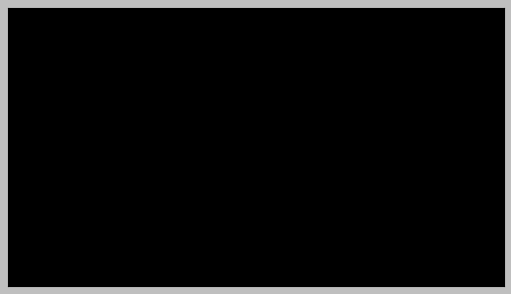

res4d_branch2c - (1, 56, 56, 64)


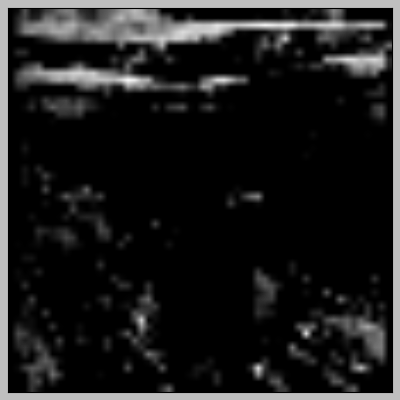

res4d_branch2c - (1, 56, 56, 256)


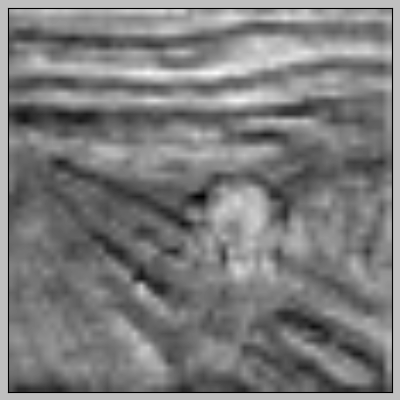

res4d_branch2c - (1, 56, 56, 256)


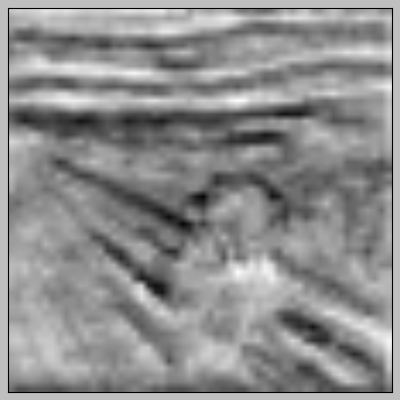

res4e_branch2a - (1, 112, 112, 64)


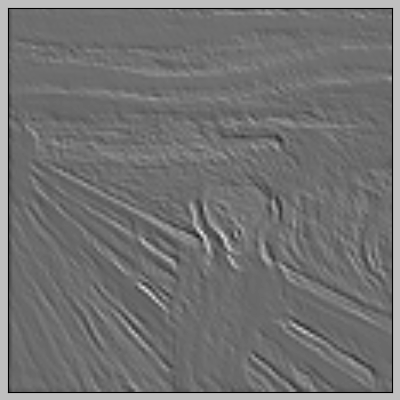

res4e_branch2a - (1, 64, 114, 114)


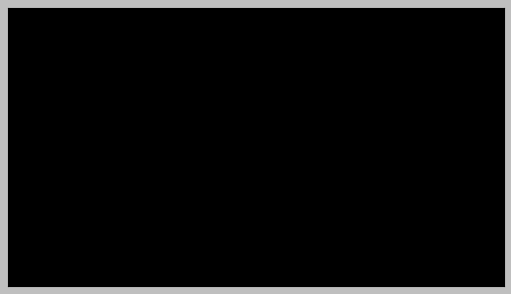

res4e_branch2a - (1, 56, 56, 64)


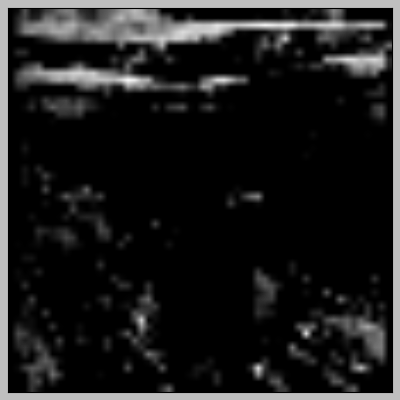

res4e_branch2a - (1, 56, 56, 256)


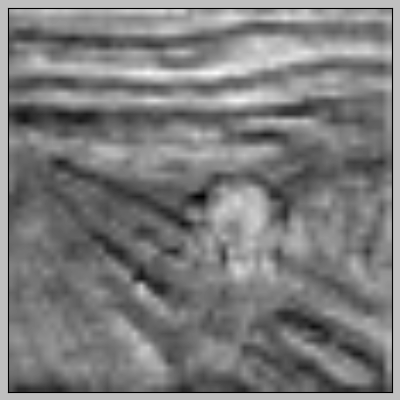

res4e_branch2a - (1, 56, 56, 256)


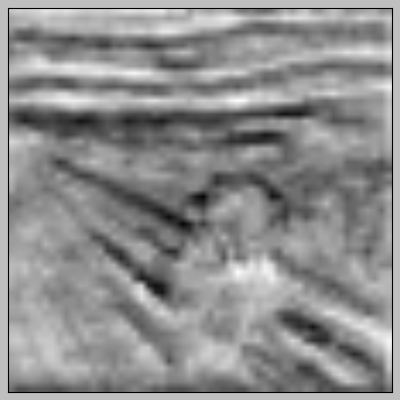

res4e_branch2b - (1, 112, 112, 64)


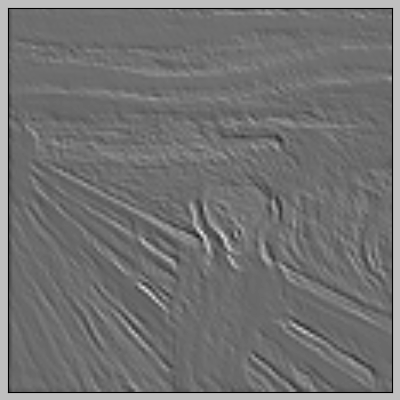

res4e_branch2b - (1, 64, 114, 114)


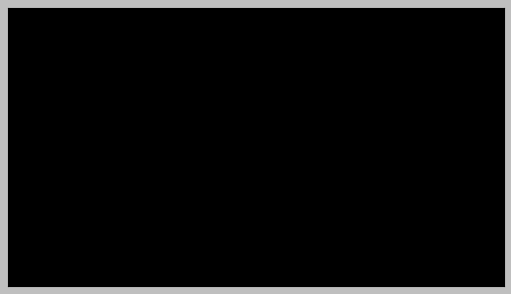

res4e_branch2b - (1, 56, 56, 64)


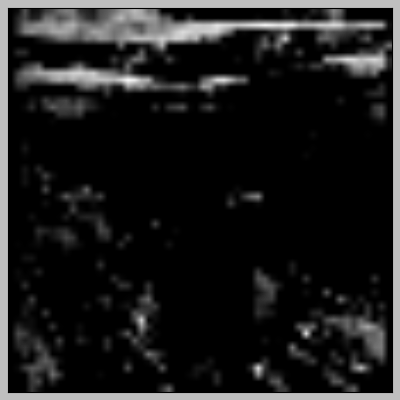

res4e_branch2b - (1, 56, 56, 256)


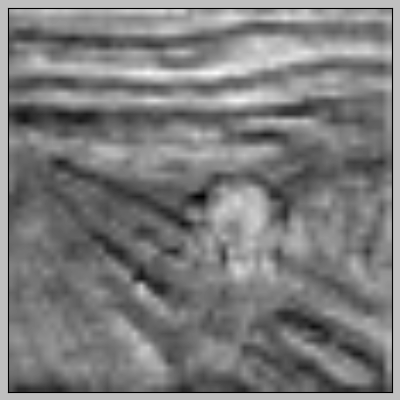

res4e_branch2b - (1, 56, 56, 256)


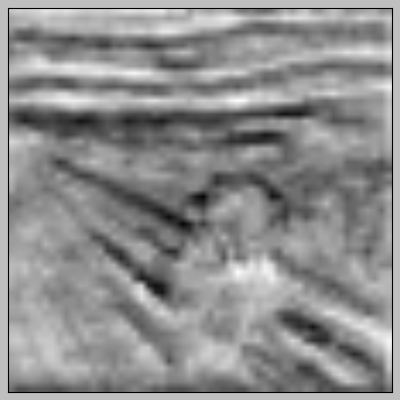

res4e_branch2c - (1, 112, 112, 64)


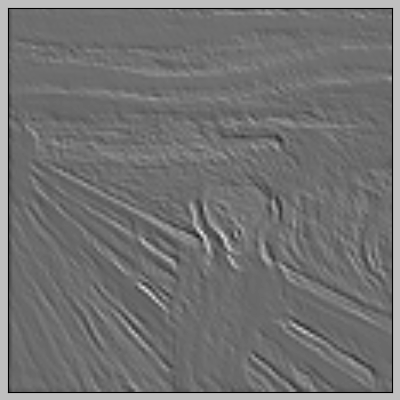

res4e_branch2c - (1, 64, 114, 114)


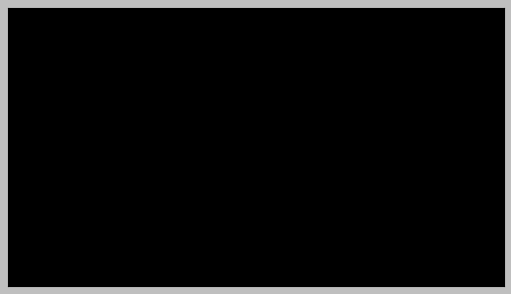

res4e_branch2c - (1, 56, 56, 64)


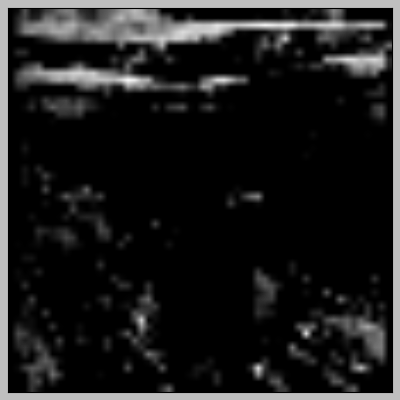

res4e_branch2c - (1, 56, 56, 256)


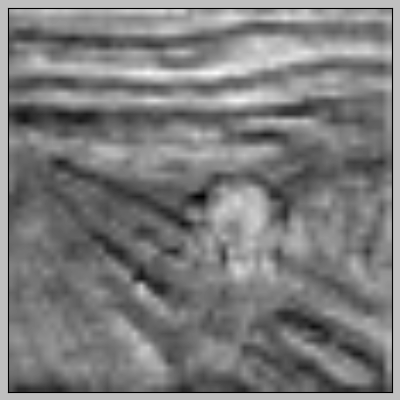

res4e_branch2c - (1, 56, 56, 256)


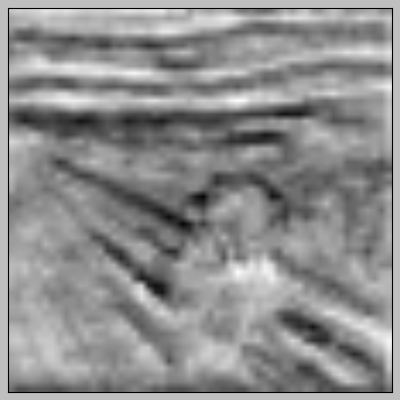

res4f_branch2a - (1, 112, 112, 64)


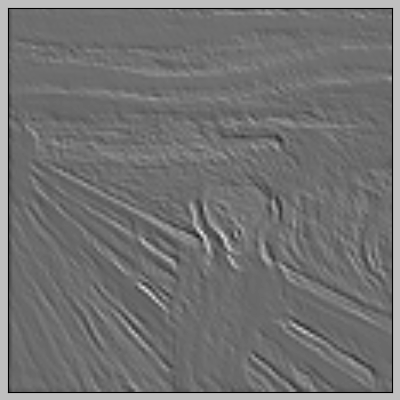

res4f_branch2a - (1, 64, 114, 114)


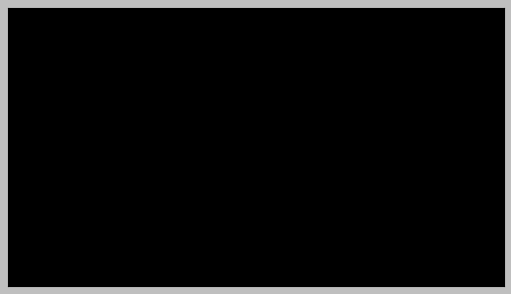

res4f_branch2a - (1, 56, 56, 64)


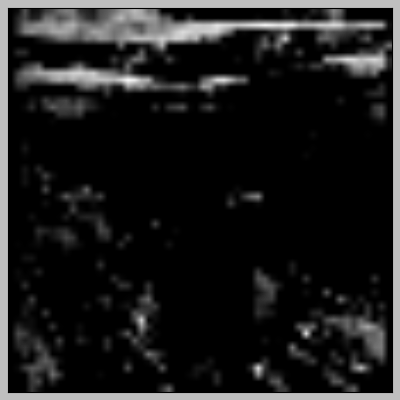

res4f_branch2a - (1, 56, 56, 256)


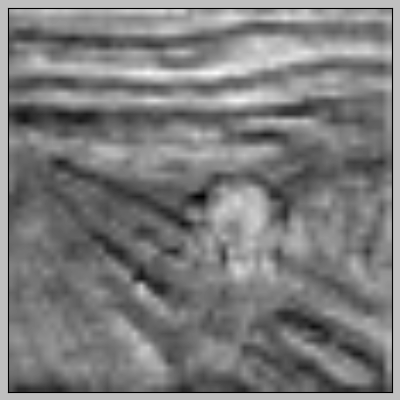

res4f_branch2a - (1, 56, 56, 256)


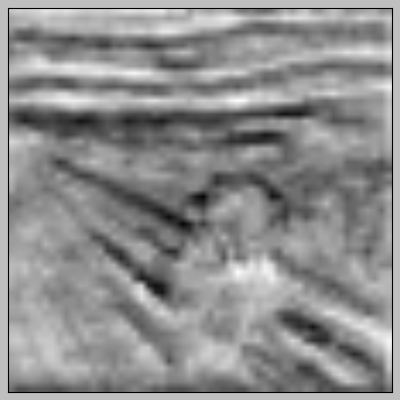

res4f_branch2b - (1, 112, 112, 64)


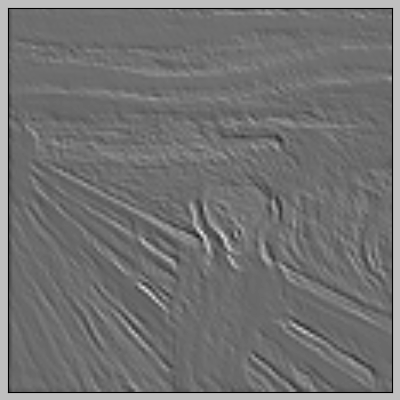

res4f_branch2b - (1, 64, 114, 114)


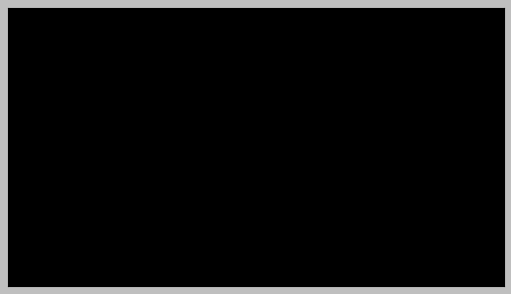

res4f_branch2b - (1, 56, 56, 64)


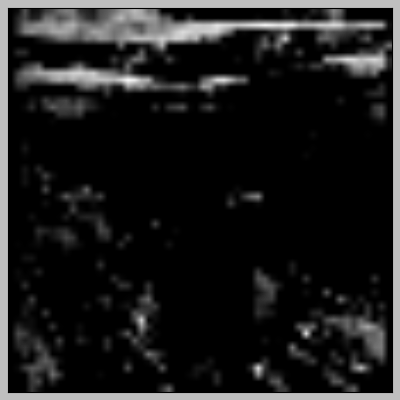

res4f_branch2b - (1, 56, 56, 256)


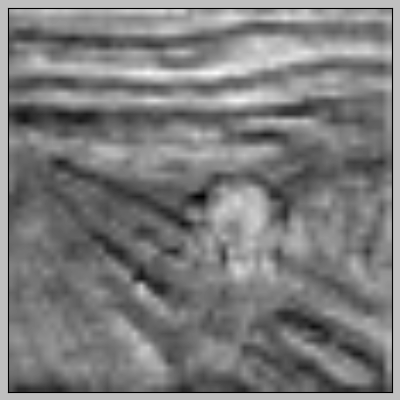

res4f_branch2b - (1, 56, 56, 256)


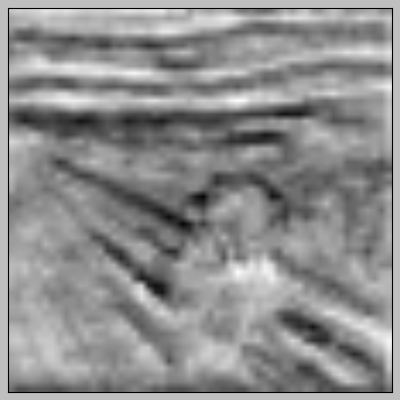

res4f_branch2c - (1, 112, 112, 64)


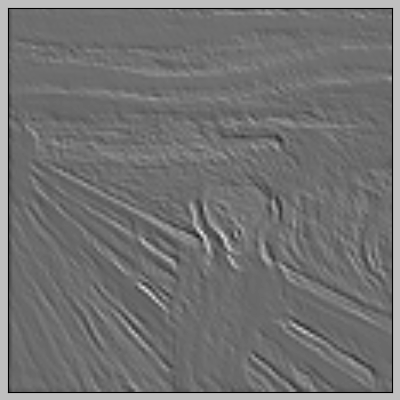

res4f_branch2c - (1, 64, 114, 114)


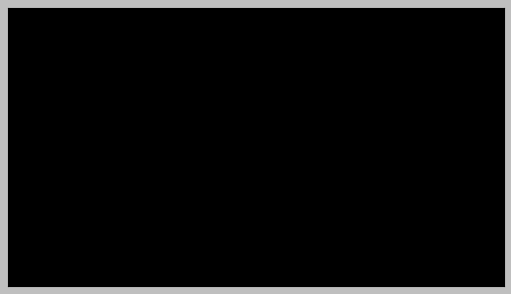

res4f_branch2c - (1, 56, 56, 64)


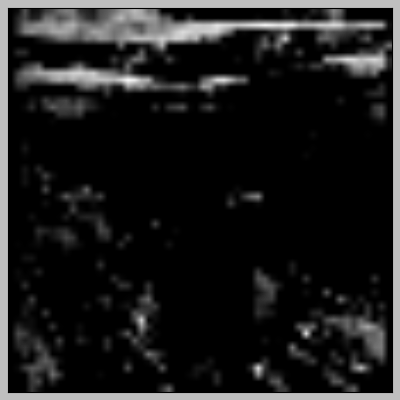

res4f_branch2c - (1, 56, 56, 256)


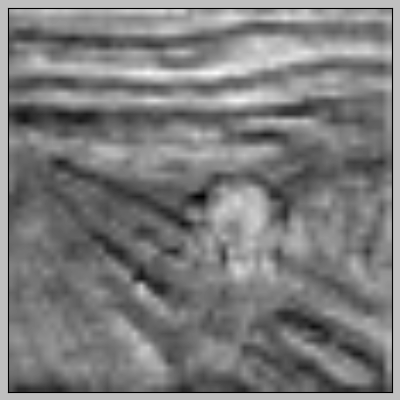

res4f_branch2c - (1, 56, 56, 256)


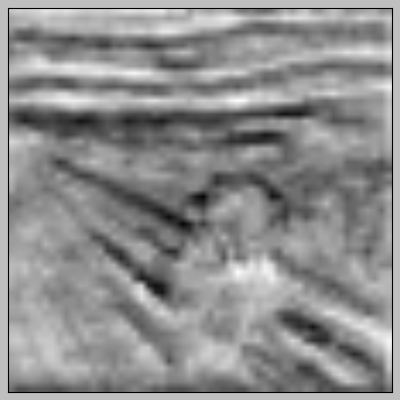

res5a_branch2a - (1, 112, 112, 64)


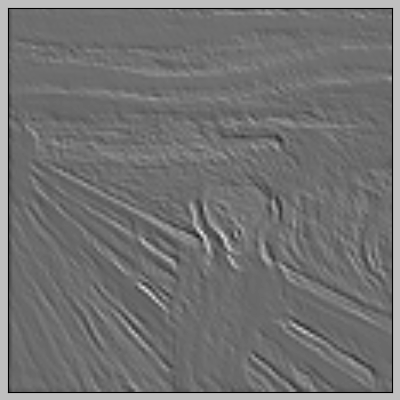

res5a_branch2a - (1, 64, 114, 114)


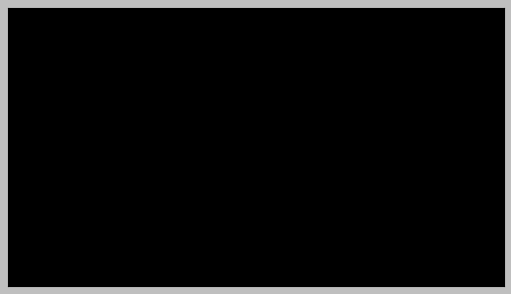

res5a_branch2a - (1, 56, 56, 64)


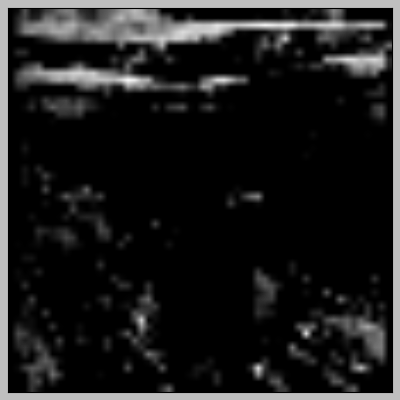

res5a_branch2a - (1, 56, 56, 256)


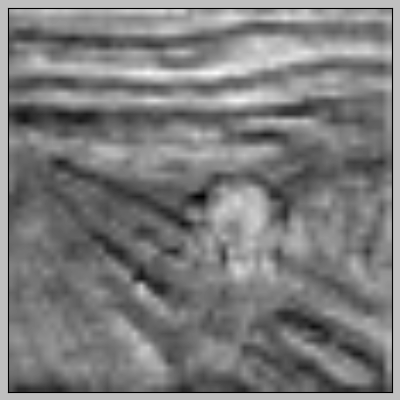

res5a_branch2a - (1, 56, 56, 256)


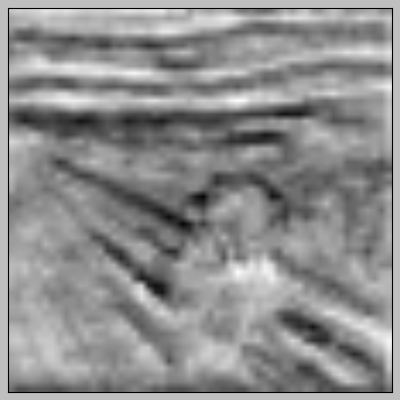

res5a_branch2b - (1, 112, 112, 64)


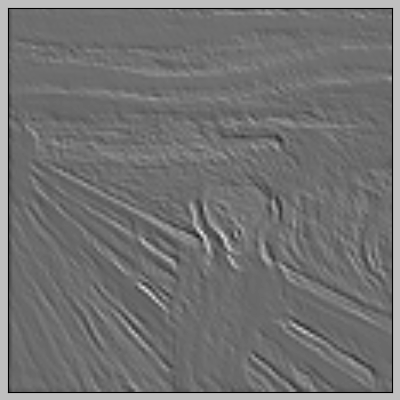

res5a_branch2b - (1, 64, 114, 114)


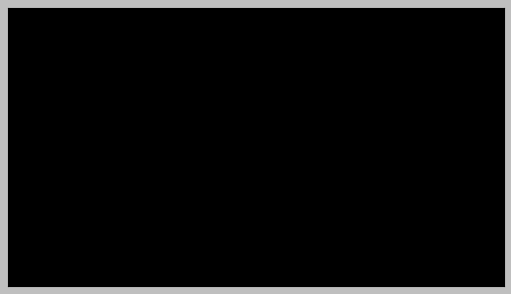

res5a_branch2b - (1, 56, 56, 64)


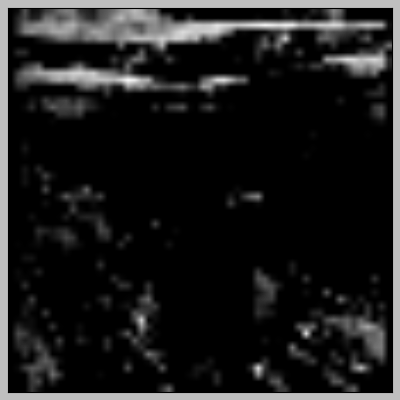

res5a_branch2b - (1, 56, 56, 256)


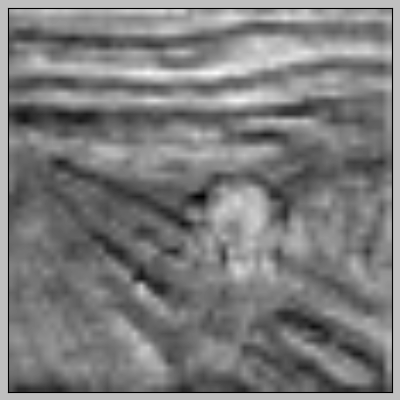

res5a_branch2b - (1, 56, 56, 256)


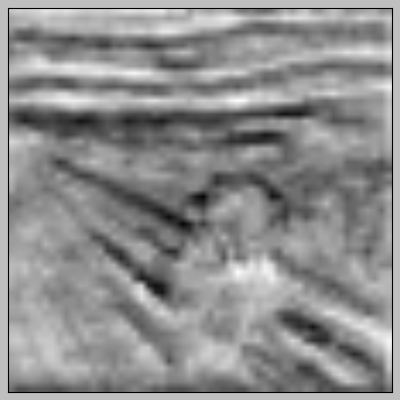

res5a_branch2c - (1, 112, 112, 64)


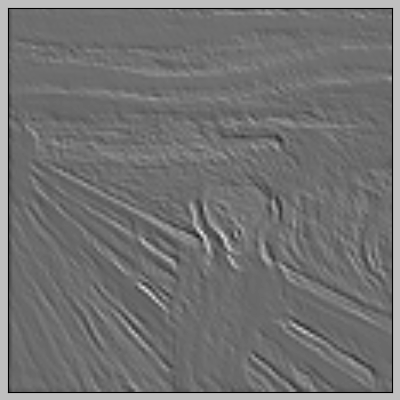

res5a_branch2c - (1, 64, 114, 114)


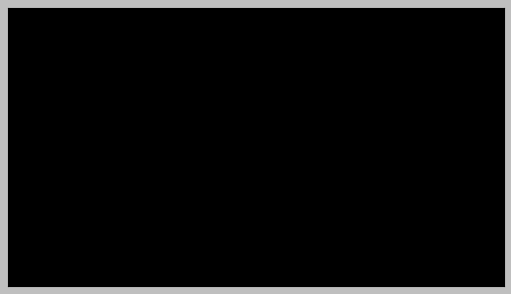

res5a_branch2c - (1, 56, 56, 64)


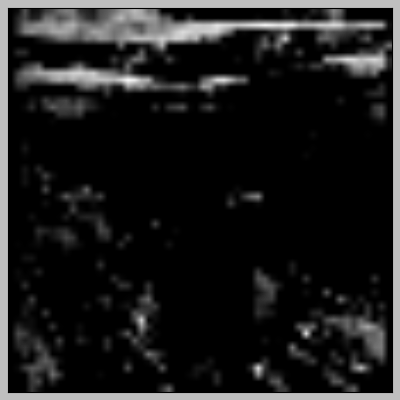

res5a_branch2c - (1, 56, 56, 256)


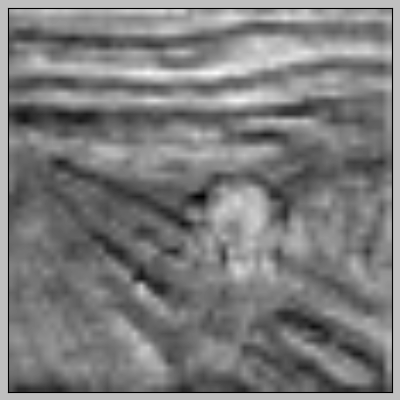

res5a_branch2c - (1, 56, 56, 256)


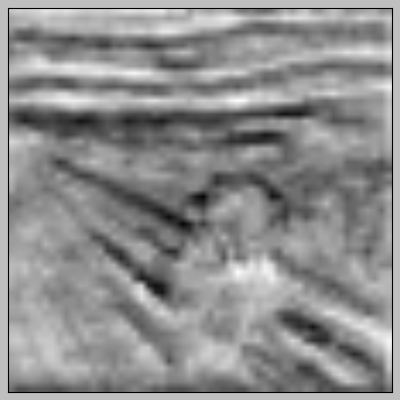

res5a_branch1 - (1, 112, 112, 64)


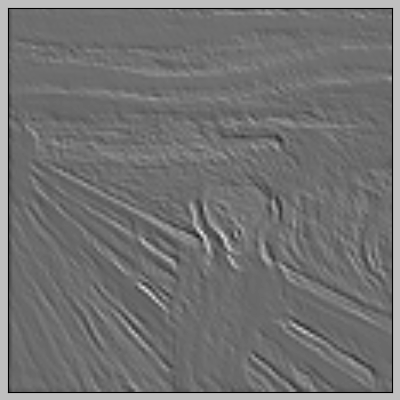

res5a_branch1 - (1, 64, 114, 114)


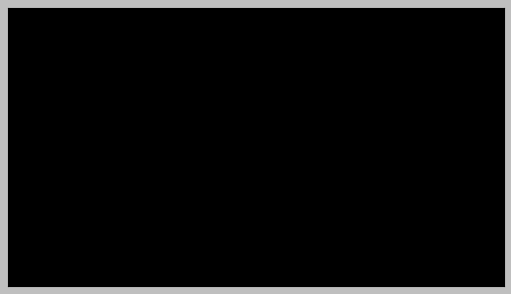

res5a_branch1 - (1, 56, 56, 64)


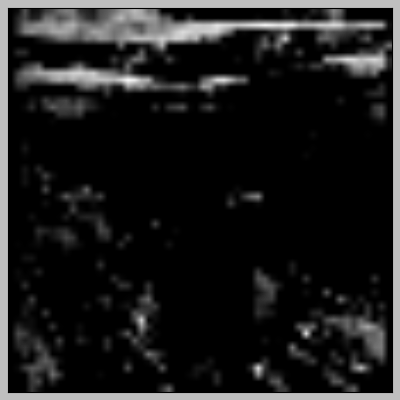

res5a_branch1 - (1, 56, 56, 256)


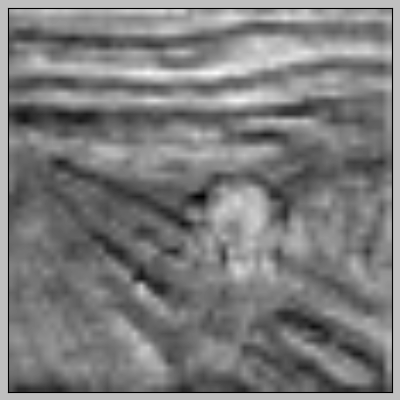

res5a_branch1 - (1, 56, 56, 256)


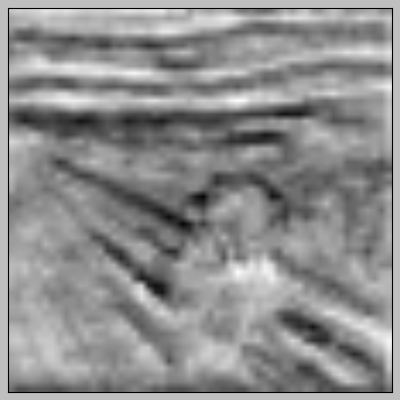

res5b_branch2a - (1, 112, 112, 64)


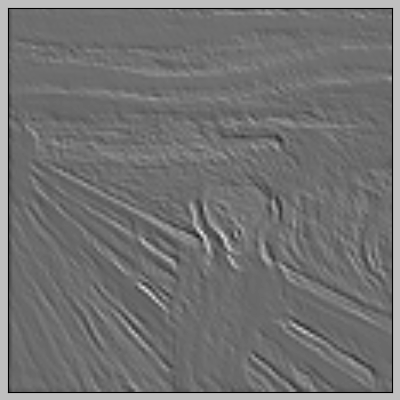

res5b_branch2a - (1, 64, 114, 114)


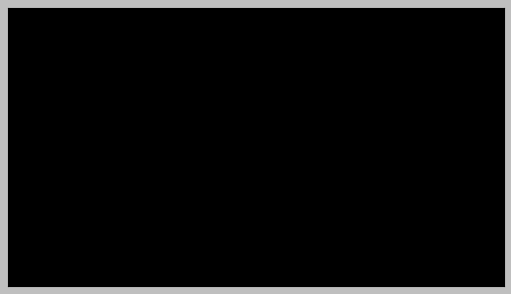

res5b_branch2a - (1, 56, 56, 64)


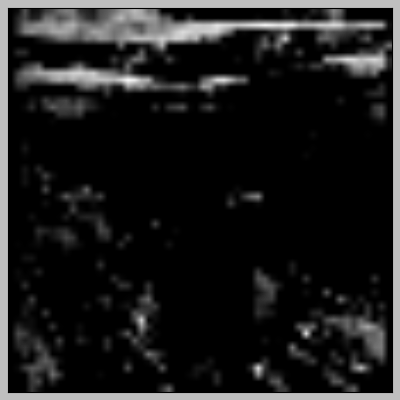

res5b_branch2a - (1, 56, 56, 256)


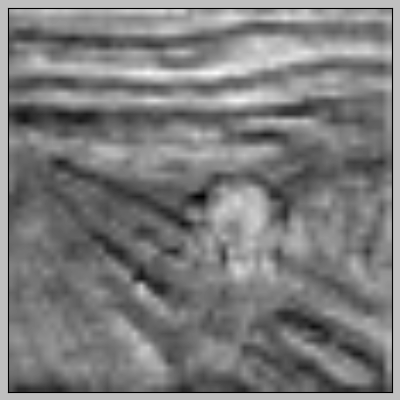

res5b_branch2a - (1, 56, 56, 256)


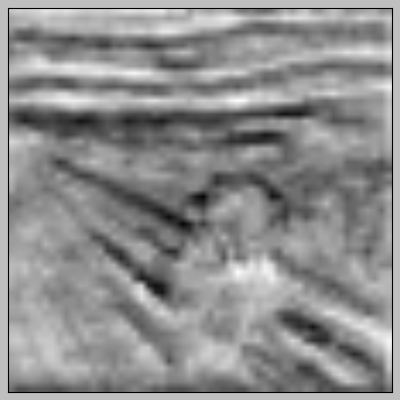

res5b_branch2b - (1, 112, 112, 64)


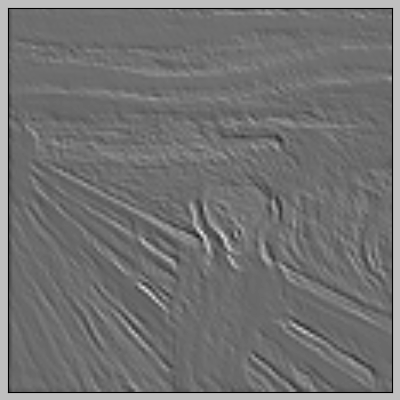

res5b_branch2b - (1, 64, 114, 114)


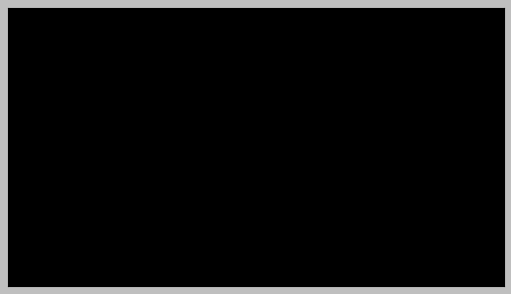

res5b_branch2b - (1, 56, 56, 64)


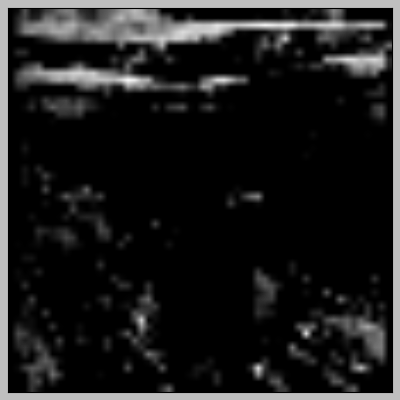

res5b_branch2b - (1, 56, 56, 256)


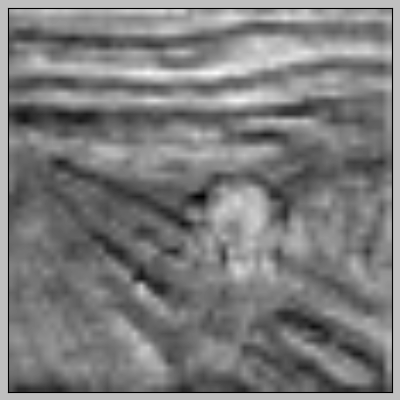

res5b_branch2b - (1, 56, 56, 256)


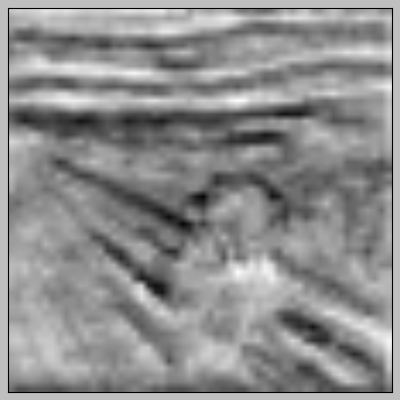

res5b_branch2c - (1, 112, 112, 64)


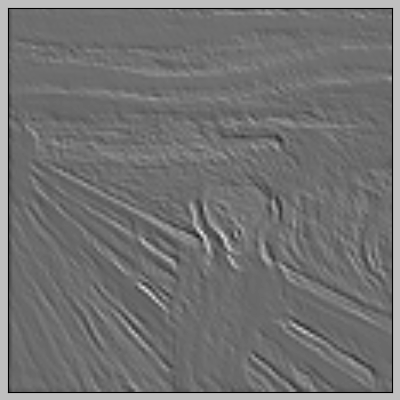

res5b_branch2c - (1, 64, 114, 114)


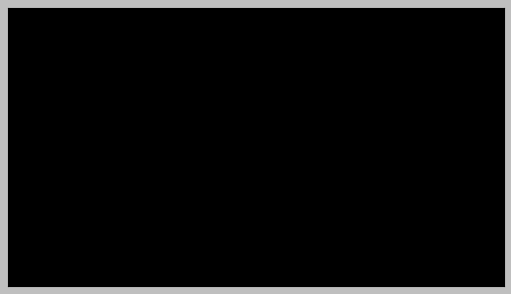

res5b_branch2c - (1, 56, 56, 64)


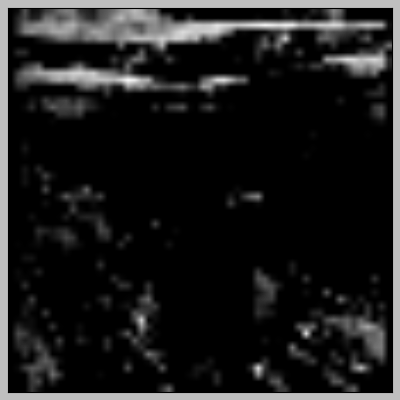

res5b_branch2c - (1, 56, 56, 256)


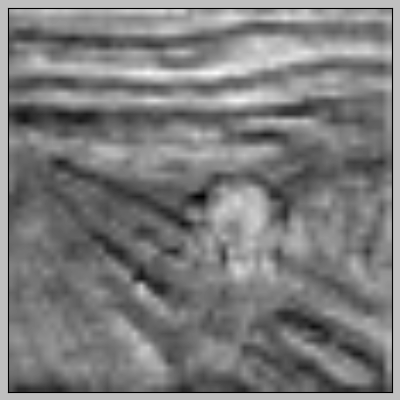

res5b_branch2c - (1, 56, 56, 256)


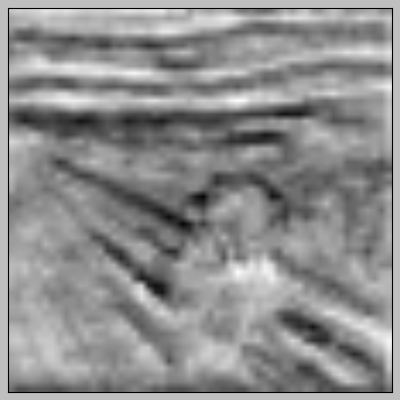

res5c_branch2a - (1, 112, 112, 64)


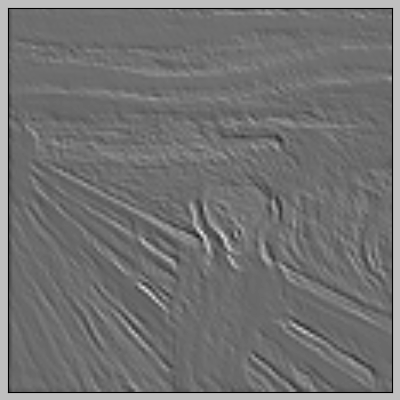

res5c_branch2a - (1, 64, 114, 114)


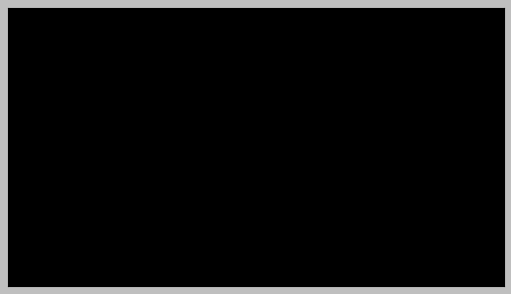

res5c_branch2a - (1, 56, 56, 64)


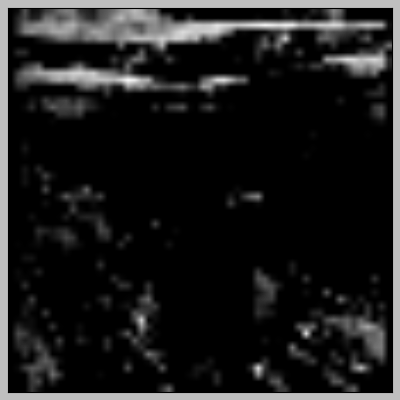

res5c_branch2a - (1, 56, 56, 256)


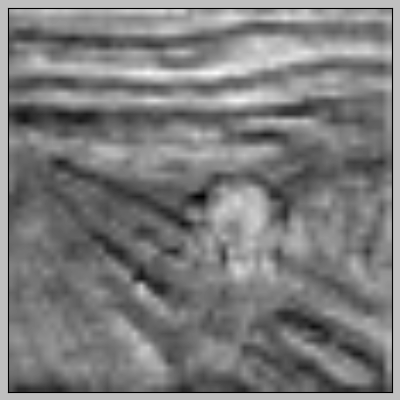

res5c_branch2a - (1, 56, 56, 256)


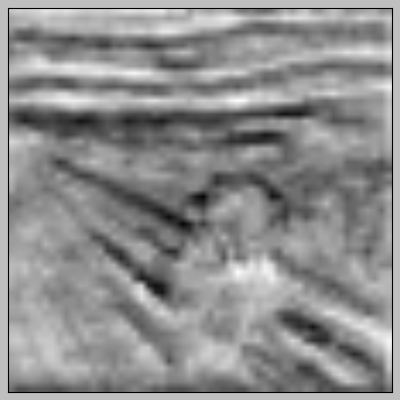

res5c_branch2b - (1, 112, 112, 64)


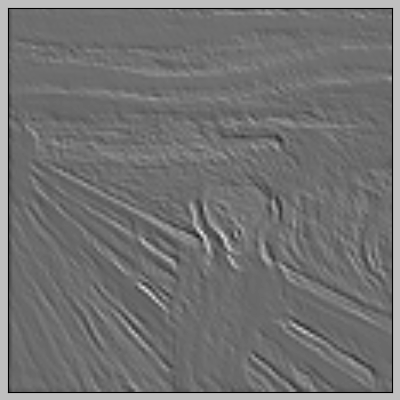

res5c_branch2b - (1, 64, 114, 114)


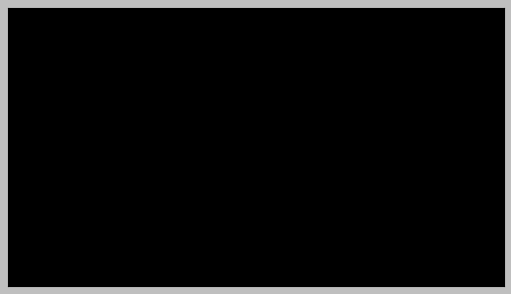

res5c_branch2b - (1, 56, 56, 64)


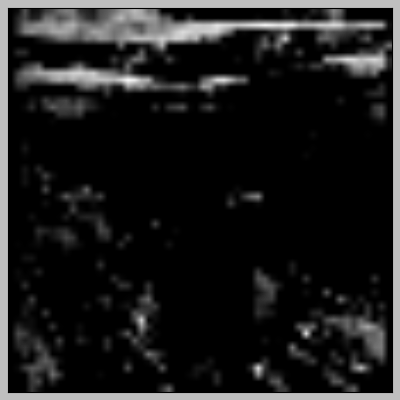

res5c_branch2b - (1, 56, 56, 256)


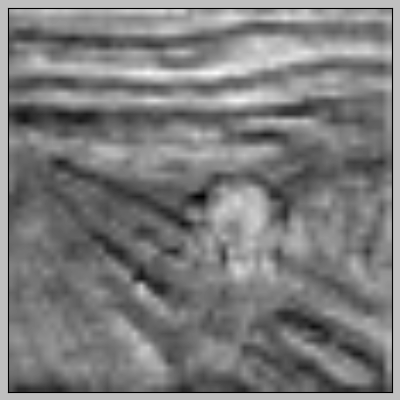

res5c_branch2b - (1, 56, 56, 256)


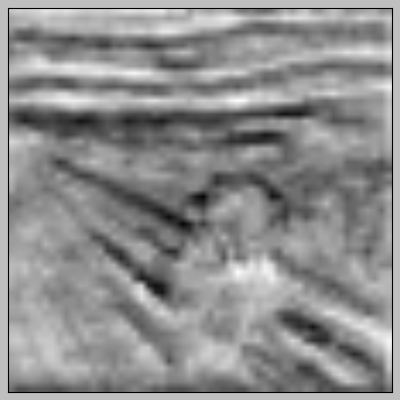

res5c_branch2c - (1, 112, 112, 64)


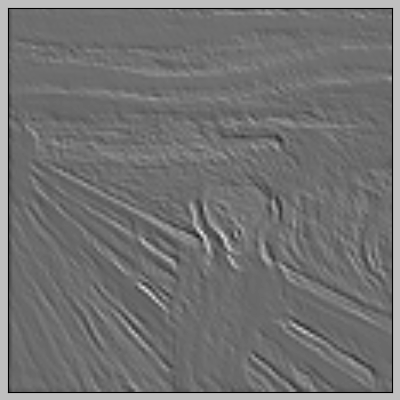

res5c_branch2c - (1, 64, 114, 114)


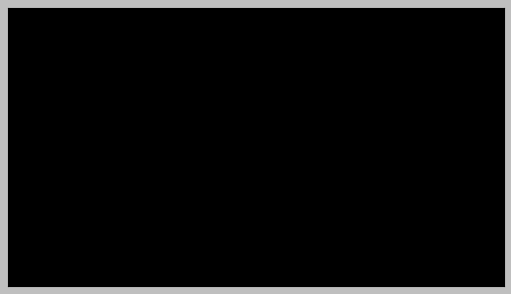

res5c_branch2c - (1, 56, 56, 64)


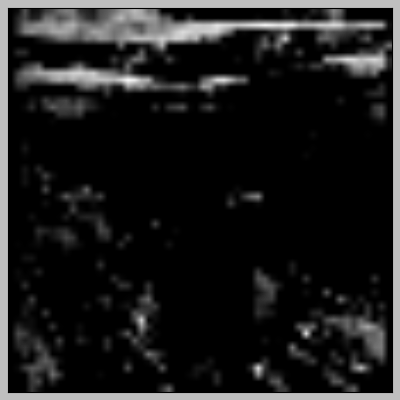

res5c_branch2c - (1, 56, 56, 256)


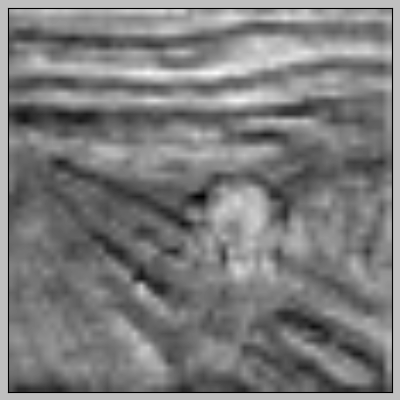

res5c_branch2c - (1, 56, 56, 256)


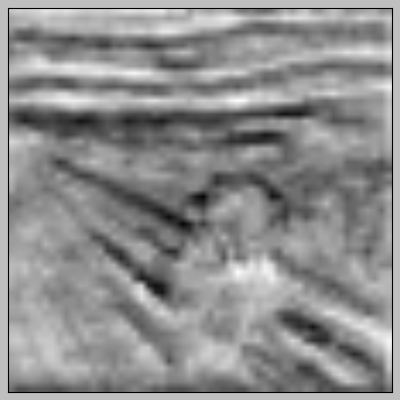

In [0]:
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.models import Model
from matplotlib import pyplot
from numpy import expand_dims

def visualize_featuremap(model):

  for layer in model.layers:
    # check for convolutional layer
    if 'res' not in layer.name:
      continue

    # redefine model to output right after the first hidden layer
    ixs = [2, 5, 9, 13, 17]

    outputs = layer.output
    outputs = [model.layers[i].output for i in ixs]
    model = Model(inputs=model.inputs, outputs=outputs)
    # load the image with the required shape
    img = load_img(PATH_IMAGES + '/scream.jpg', target_size=(224, 224))
    # convert the image to an array
    img = img_to_array(img)
    # expand dimensions so that it represents a single 'sample'
    img = expand_dims(img, axis=0)
    # prepare the image (e.g. scale pixel values for the vgg)
    img = preprocess_input(img)
    # get feature map for first hidden layer
    feature_maps = model.predict(img)
    # plot the output from each block
    square = 1
    for fmap in feature_maps:
      title = layer.name + " - " + str(fmap.shape).replace("'", '')
      print(title)

      # plot all 64 maps in an 8x8 squares
      ix = 1
      for _ in range(square):
        for _ in range(square):
          # specify subplot and turn of axis
          ax = pyplot.subplot(square, square, ix)
          ax.set_xticks([])
          ax.set_yticks([])
          # plot filter channel in grayscale
          pyplot.imshow(fmap[0, :, :, ix-1], cmap='gray')
          pyplot.savefig(PATH_VISUALIZE + "/feature-map/" + title + '.png')

          ix += 1
      # show the figure
      pyplot.show()

# model.summary()
visualize_featuremap(model)